In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression, LogisticRegressionCV, Lasso, lars_path
from sklearn.naive_bayes import MultinomialNB,GaussianNB,BernoulliNB
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier,VotingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, KFold, cross_val_score, GridSearchCV, RandomizedSearchCV
from sklearn.metrics import confusion_matrix, precision_score, recall_score, precision_recall_curve,f1_score, roc_auc_score, roc_curve, log_loss,classification_report

from ipywidgets import interactive

pd.set_option('display.max_columns', 500)
pd.set_option('display.max_rows', 500)

import warnings
warnings.filterwarnings("ignore")

%matplotlib inline

In [2]:
df = pd.read_csv('Airline_Dataset.csv')

In [3]:
df

,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,Satisfaction
0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,5,3,5,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,3,1,3,1,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,2,5,5,5,5,4,3,4,4,4,5,0,0.0,satisfied
3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,5,2,2,2,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,3,4,5,5,3,3,4,4,3,3,3,0,0.0,satisfied
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129875,78463,Male,disloyal Customer,34,Business travel,Business,526,3,3,3,1,4,3,4,4,3,2,4,4,5,4,0,0.0,neutral or dissatisfied
129876,71167,Male,Loyal Customer,23,Business travel,Business,646,4,4,4,4,4,4,4,4,4,5,5,5,5,4,0,0.0,satisfied
129877,37675,Female,Loyal Customer,17,Personal Travel,Eco,828,2,5,1,5,2,1,2,2,4,3,4,5,4,2,0,0.0,neutral or dissatisfied
129878,90086,Male,Loyal Customer,14,Business travel,Business,1127,3,3,3,3,4,4,4,4,3,2,5,4,5,4,0,0.0,satisfied


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 129880 entries, 0 to 129879
Data columns (total 24 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   id                                 129880 non-null  int64  
 1   Gender                             129880 non-null  object 
 2   Customer Type                      129880 non-null  object 
 3   Age                                129880 non-null  int64  
 4   Type of Travel                     129880 non-null  object 
 5   Class                              129880 non-null  object 
 6   Flight Distance                    129880 non-null  int64  
 7   Inflight wifi service              129880 non-null  int64  
 8   Departure/Arrival time convenient  129880 non-null  int64  
 9   Ease of Online booking             129880 non-null  int64  
 10  Gate location                      129880 non-null  int64  
 11  Food and drink                     1298

# Data Preprocessing / Data Cleaning

In [5]:
df['Customer Type'] = df['Customer Type'].map({'Loyal Customer':'Returning Customer','disloyal Customer':'First-time Customer'})

In [6]:
df

,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,Satisfaction
0,70172,Male,Returning Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,5,3,5,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,5047,Male,First-time Customer,25,Business travel,Business,235,3,2,3,3,1,3,1,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,110028,Female,Returning Customer,26,Business travel,Business,1142,2,2,2,2,5,5,5,5,4,3,4,4,4,5,0,0.0,satisfied
3,24026,Female,Returning Customer,25,Business travel,Business,562,2,5,5,5,2,2,2,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,119299,Male,Returning Customer,61,Business travel,Business,214,3,3,3,3,4,5,5,3,3,4,4,3,3,3,0,0.0,satisfied
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129875,78463,Male,First-time Customer,34,Business travel,Business,526,3,3,3,1,4,3,4,4,3,2,4,4,5,4,0,0.0,neutral or dissatisfied
129876,71167,Male,Returning Customer,23,Business travel,Business,646,4,4,4,4,4,4,4,4,4,5,5,5,5,4,0,0.0,satisfied
129877,37675,Female,Returning Customer,17,Personal Travel,Eco,828,2,5,1,5,2,1,2,2,4,3,4,5,4,2,0,0.0,neutral or dissatisfied
129878,90086,Male,Returning Customer,14,Business travel,Business,1127,3,3,3,3,4,4,4,4,3,2,5,4,5,4,0,0.0,satisfied


In [7]:
df.isnull().sum()

id                                     0
Gender                                 0
Customer Type                          0
Age                                    0
Type of Travel                         0
Class                                  0
Flight Distance                        0
Inflight wifi service                  0
Departure/Arrival time convenient      0
Ease of Online booking                 0
Gate location                          0
Food and drink                         0
Online boarding                        0
Seat comfort                           0
Inflight entertainment                 0
On-board service                       0
Leg room service                       0
Baggage handling                       0
Checkin service                        0
Inflight service                       0
Cleanliness                            0
Departure Delay in Minutes             0
Arrival Delay in Minutes             393
Satisfaction                           0
dtype: int64

In [8]:
df = df.dropna(axis=0)

In [9]:
df['Departure Delay in Minutes'] = df['Departure Delay in Minutes'].astype('float')

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 129487 entries, 0 to 129879
Data columns (total 24 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   id                                 129487 non-null  int64  
 1   Gender                             129487 non-null  object 
 2   Customer Type                      129487 non-null  object 
 3   Age                                129487 non-null  int64  
 4   Type of Travel                     129487 non-null  object 
 5   Class                              129487 non-null  object 
 6   Flight Distance                    129487 non-null  int64  
 7   Inflight wifi service              129487 non-null  int64  
 8   Departure/Arrival time convenient  129487 non-null  int64  
 9   Ease of Online booking             129487 non-null  int64  
 10  Gate location                      129487 non-null  int64  
 11  Food and drink                     1294

In [11]:
df.describe()

,id,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes
count,129487.000000,129487.000000,129487.000000,129487.000000,129487.000000,129487.000000,129487.000000,129487.000000,129487.000000,129487.000000,129487.000000,129487.000000,129487.000000,129487.000000,129487.000000,129487.000000,129487.000000,129487.000000,129487.000000
mean,64958.335169,39.428761,1190.210662,2.728544,3.057349,2.756786,2.976909,3.204685,3.252720,3.441589,3.358067,3.383204,3.351078,3.631886,3.306239,3.642373,3.286222,14.643385,15.091129
std,37489.781165,15.117597,997.560954,1.329235,1.526787,1.401662,1.278506,1.329905,1.350651,1.319168,1.334149,1.287032,1.316132,1.180082,1.266146,1.176614,1.313624,37.932867,38.465650
min,1.000000,7.000000,31.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,32494.500000,27.000000,414.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,3.000000,3.000000,3.000000,2.000000,0.000000,0.000000
50%,64972.000000,40.000000,844.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,4.000000,4.000000,4.000000,4.000000,4.000000,3.000000,4.000000,3.000000,0.000000,0.000000
75%,97415.500000,51.000000,1744.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,5.000000,4.000000,4.000000,4.000000,5.000000,4.000000,5.000000,4.000000,12.000000,13.000000
max,129880.000000,85.000000,4983.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,1592.000000,1584.000000


In [12]:
df

,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,Satisfaction
0,70172,Male,Returning Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,5,3,5,5,4,3,4,4,5,5,25.0,18.0,neutral or dissatisfied
1,5047,Male,First-time Customer,25,Business travel,Business,235,3,2,3,3,1,3,1,1,1,5,3,1,4,1,1.0,6.0,neutral or dissatisfied
2,110028,Female,Returning Customer,26,Business travel,Business,1142,2,2,2,2,5,5,5,5,4,3,4,4,4,5,0.0,0.0,satisfied
3,24026,Female,Returning Customer,25,Business travel,Business,562,2,5,5,5,2,2,2,2,2,5,3,1,4,2,11.0,9.0,neutral or dissatisfied
4,119299,Male,Returning Customer,61,Business travel,Business,214,3,3,3,3,4,5,5,3,3,4,4,3,3,3,0.0,0.0,satisfied
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129875,78463,Male,First-time Customer,34,Business travel,Business,526,3,3,3,1,4,3,4,4,3,2,4,4,5,4,0.0,0.0,neutral or dissatisfied
129876,71167,Male,Returning Customer,23,Business travel,Business,646,4,4,4,4,4,4,4,4,4,5,5,5,5,4,0.0,0.0,satisfied
129877,37675,Female,Returning Customer,17,Personal Travel,Eco,828,2,5,1,5,2,1,2,2,4,3,4,5,4,2,0.0,0.0,neutral or dissatisfied
129878,90086,Male,Returning Customer,14,Business travel,Business,1127,3,3,3,3,4,4,4,4,3,2,5,4,5,4,0.0,0.0,satisfied


In [13]:
df.isnull().sum()

id                                   0
Gender                               0
Customer Type                        0
Age                                  0
Type of Travel                       0
Class                                0
Flight Distance                      0
Inflight wifi service                0
Departure/Arrival time convenient    0
Ease of Online booking               0
Gate location                        0
Food and drink                       0
Online boarding                      0
Seat comfort                         0
Inflight entertainment               0
On-board service                     0
Leg room service                     0
Baggage handling                     0
Checkin service                      0
Inflight service                     0
Cleanliness                          0
Departure Delay in Minutes           0
Arrival Delay in Minutes             0
Satisfaction                         0
dtype: int64

In [14]:
df = df.rename(columns={'Leg room service':'Leg room'})

In [15]:
df.columns

Index(['id', 'Gender', 'Customer Type', 'Age', 'Type of Travel', 'Class',
       'Flight Distance', 'Inflight wifi service',
       'Departure/Arrival time convenient', 'Ease of Online booking',
       'Gate location', 'Food and drink', 'Online boarding', 'Seat comfort',
       'Inflight entertainment', 'On-board service', 'Leg room',
       'Baggage handling', 'Checkin service', 'Inflight service',
       'Cleanliness', 'Departure Delay in Minutes', 'Arrival Delay in Minutes',
       'Satisfaction'],
      dtype='object')

In [16]:
from string import capwords
df.columns = [capwords(i) for i in df.columns]
df = df.rename(columns={'Departure/arrival Time Convenient':'Departure/Arrival Time Convenience'})

In [17]:
df

,Id,Gender,Customer Type,Age,Type Of Travel,Class,Flight Distance,Inflight Wifi Service,Departure/Arrival Time Convenience,Ease Of Online Booking,Gate Location,Food And Drink,Online Boarding,Seat Comfort,Inflight Entertainment,On-board Service,Leg Room,Baggage Handling,Checkin Service,Inflight Service,Cleanliness,Departure Delay In Minutes,Arrival Delay In Minutes,Satisfaction
0,70172,Male,Returning Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,5,3,5,5,4,3,4,4,5,5,25.0,18.0,neutral or dissatisfied
1,5047,Male,First-time Customer,25,Business travel,Business,235,3,2,3,3,1,3,1,1,1,5,3,1,4,1,1.0,6.0,neutral or dissatisfied
2,110028,Female,Returning Customer,26,Business travel,Business,1142,2,2,2,2,5,5,5,5,4,3,4,4,4,5,0.0,0.0,satisfied
3,24026,Female,Returning Customer,25,Business travel,Business,562,2,5,5,5,2,2,2,2,2,5,3,1,4,2,11.0,9.0,neutral or dissatisfied
4,119299,Male,Returning Customer,61,Business travel,Business,214,3,3,3,3,4,5,5,3,3,4,4,3,3,3,0.0,0.0,satisfied
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129875,78463,Male,First-time Customer,34,Business travel,Business,526,3,3,3,1,4,3,4,4,3,2,4,4,5,4,0.0,0.0,neutral or dissatisfied
129876,71167,Male,Returning Customer,23,Business travel,Business,646,4,4,4,4,4,4,4,4,4,5,5,5,5,4,0.0,0.0,satisfied
129877,37675,Female,Returning Customer,17,Personal Travel,Eco,828,2,5,1,5,2,1,2,2,4,3,4,5,4,2,0.0,0.0,neutral or dissatisfied
129878,90086,Male,Returning Customer,14,Business travel,Business,1127,3,3,3,3,4,4,4,4,3,2,5,4,5,4,0.0,0.0,satisfied


In [18]:
df = df[(df['Inflight Wifi Service']!=0)&(df['Departure/Arrival Time Convenience']!=0)&(df['Ease Of Online Booking']!=0)&(df['Gate Location']!=0)&(df['Food And Drink']!=0)&(df['Online Boarding']!=0)&(df['Seat Comfort']!=0)&(df['Inflight Entertainment']!=0)&(df['On-board Service']!=0)&(df['Leg Room']!=0)&(df['Baggage Handling']!=0)&(df['Checkin Service']!=0)&(df['Inflight Service']!=0)&(df['Cleanliness']!=0)]

In [19]:
df['Satisfaction'] = df['Satisfaction'].map({'satisfied':1,'neutral or dissatisfied':0})
df = df.reset_index()
df

,index,Id,Gender,Customer Type,Age,Type Of Travel,Class,Flight Distance,Inflight Wifi Service,Departure/Arrival Time Convenience,Ease Of Online Booking,Gate Location,Food And Drink,Online Boarding,Seat Comfort,Inflight Entertainment,On-board Service,Leg Room,Baggage Handling,Checkin Service,Inflight Service,Cleanliness,Departure Delay In Minutes,Arrival Delay In Minutes,Satisfaction
0,0,70172,Male,Returning Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,5,3,5,5,4,3,4,4,5,5,25.0,18.0,0
1,1,5047,Male,First-time Customer,25,Business travel,Business,235,3,2,3,3,1,3,1,1,1,5,3,1,4,1,1.0,6.0,0
2,2,110028,Female,Returning Customer,26,Business travel,Business,1142,2,2,2,2,5,5,5,5,4,3,4,4,4,5,0.0,0.0,1
3,3,24026,Female,Returning Customer,25,Business travel,Business,562,2,5,5,5,2,2,2,2,2,5,3,1,4,2,11.0,9.0,0
4,4,119299,Male,Returning Customer,61,Business travel,Business,214,3,3,3,3,4,5,5,3,3,4,4,3,3,3,0.0,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119199,129875,78463,Male,First-time Customer,34,Business travel,Business,526,3,3,3,1,4,3,4,4,3,2,4,4,5,4,0.0,0.0,0
119200,129876,71167,Male,Returning Customer,23,Business travel,Business,646,4,4,4,4,4,4,4,4,4,5,5,5,5,4,0.0,0.0,1
119201,129877,37675,Female,Returning Customer,17,Personal Travel,Eco,828,2,5,1,5,2,1,2,2,4,3,4,5,4,2,0.0,0.0,0
119202,129878,90086,Male,Returning Customer,14,Business travel,Business,1127,3,3,3,3,4,4,4,4,3,2,5,4,5,4,0.0,0.0,1


In [20]:
df = df.drop('index',axis=1)
df

,Id,Gender,Customer Type,Age,Type Of Travel,Class,Flight Distance,Inflight Wifi Service,Departure/Arrival Time Convenience,Ease Of Online Booking,Gate Location,Food And Drink,Online Boarding,Seat Comfort,Inflight Entertainment,On-board Service,Leg Room,Baggage Handling,Checkin Service,Inflight Service,Cleanliness,Departure Delay In Minutes,Arrival Delay In Minutes,Satisfaction
0,70172,Male,Returning Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,5,3,5,5,4,3,4,4,5,5,25.0,18.0,0
1,5047,Male,First-time Customer,25,Business travel,Business,235,3,2,3,3,1,3,1,1,1,5,3,1,4,1,1.0,6.0,0
2,110028,Female,Returning Customer,26,Business travel,Business,1142,2,2,2,2,5,5,5,5,4,3,4,4,4,5,0.0,0.0,1
3,24026,Female,Returning Customer,25,Business travel,Business,562,2,5,5,5,2,2,2,2,2,5,3,1,4,2,11.0,9.0,0
4,119299,Male,Returning Customer,61,Business travel,Business,214,3,3,3,3,4,5,5,3,3,4,4,3,3,3,0.0,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119199,78463,Male,First-time Customer,34,Business travel,Business,526,3,3,3,1,4,3,4,4,3,2,4,4,5,4,0.0,0.0,0
119200,71167,Male,Returning Customer,23,Business travel,Business,646,4,4,4,4,4,4,4,4,4,5,5,5,5,4,0.0,0.0,1
119201,37675,Female,Returning Customer,17,Personal Travel,Eco,828,2,5,1,5,2,1,2,2,4,3,4,5,4,2,0.0,0.0,0
119202,90086,Male,Returning Customer,14,Business travel,Business,1127,3,3,3,3,4,4,4,4,3,2,5,4,5,4,0.0,0.0,1


In [21]:
df['Total Delay'] = df['Departure Delay In Minutes'] + df['Arrival Delay In Minutes']

In [22]:
df

,Id,Gender,Customer Type,Age,Type Of Travel,Class,Flight Distance,Inflight Wifi Service,Departure/Arrival Time Convenience,Ease Of Online Booking,Gate Location,Food And Drink,Online Boarding,Seat Comfort,Inflight Entertainment,On-board Service,Leg Room,Baggage Handling,Checkin Service,Inflight Service,Cleanliness,Departure Delay In Minutes,Arrival Delay In Minutes,Satisfaction,Total Delay
0,70172,Male,Returning Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,5,3,5,5,4,3,4,4,5,5,25.0,18.0,0,43.0
1,5047,Male,First-time Customer,25,Business travel,Business,235,3,2,3,3,1,3,1,1,1,5,3,1,4,1,1.0,6.0,0,7.0
2,110028,Female,Returning Customer,26,Business travel,Business,1142,2,2,2,2,5,5,5,5,4,3,4,4,4,5,0.0,0.0,1,0.0
3,24026,Female,Returning Customer,25,Business travel,Business,562,2,5,5,5,2,2,2,2,2,5,3,1,4,2,11.0,9.0,0,20.0
4,119299,Male,Returning Customer,61,Business travel,Business,214,3,3,3,3,4,5,5,3,3,4,4,3,3,3,0.0,0.0,1,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119199,78463,Male,First-time Customer,34,Business travel,Business,526,3,3,3,1,4,3,4,4,3,2,4,4,5,4,0.0,0.0,0,0.0
119200,71167,Male,Returning Customer,23,Business travel,Business,646,4,4,4,4,4,4,4,4,4,5,5,5,5,4,0.0,0.0,1,0.0
119201,37675,Female,Returning Customer,17,Personal Travel,Eco,828,2,5,1,5,2,1,2,2,4,3,4,5,4,2,0.0,0.0,0,0.0
119202,90086,Male,Returning Customer,14,Business travel,Business,1127,3,3,3,3,4,4,4,4,3,2,5,4,5,4,0.0,0.0,1,0.0


In [23]:
DF = df.copy()
df = df.drop('Id',axis=1)

In [24]:
df = df.reindex(columns=['Satisfaction']+list(df.columns)[:-2]+['Total Delay'])
df

,Satisfaction,Gender,Customer Type,Age,Type Of Travel,Class,Flight Distance,Inflight Wifi Service,Departure/Arrival Time Convenience,Ease Of Online Booking,Gate Location,Food And Drink,Online Boarding,Seat Comfort,Inflight Entertainment,On-board Service,Leg Room,Baggage Handling,Checkin Service,Inflight Service,Cleanliness,Departure Delay In Minutes,Arrival Delay In Minutes,Total Delay
0,0,Male,Returning Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,5,3,5,5,4,3,4,4,5,5,25.0,18.0,43.0
1,0,Male,First-time Customer,25,Business travel,Business,235,3,2,3,3,1,3,1,1,1,5,3,1,4,1,1.0,6.0,7.0
2,1,Female,Returning Customer,26,Business travel,Business,1142,2,2,2,2,5,5,5,5,4,3,4,4,4,5,0.0,0.0,0.0
3,0,Female,Returning Customer,25,Business travel,Business,562,2,5,5,5,2,2,2,2,2,5,3,1,4,2,11.0,9.0,20.0
4,1,Male,Returning Customer,61,Business travel,Business,214,3,3,3,3,4,5,5,3,3,4,4,3,3,3,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119199,0,Male,First-time Customer,34,Business travel,Business,526,3,3,3,1,4,3,4,4,3,2,4,4,5,4,0.0,0.0,0.0
119200,1,Male,Returning Customer,23,Business travel,Business,646,4,4,4,4,4,4,4,4,4,5,5,5,5,4,0.0,0.0,0.0
119201,0,Female,Returning Customer,17,Personal Travel,Eco,828,2,5,1,5,2,1,2,2,4,3,4,5,4,2,0.0,0.0,0.0
119202,1,Male,Returning Customer,14,Business travel,Business,1127,3,3,3,3,4,4,4,4,3,2,5,4,5,4,0.0,0.0,0.0


In [25]:
df = df.drop(['Departure Delay In Minutes','Arrival Delay In Minutes'],axis=1)
df

,Satisfaction,Gender,Customer Type,Age,Type Of Travel,Class,Flight Distance,Inflight Wifi Service,Departure/Arrival Time Convenience,Ease Of Online Booking,Gate Location,Food And Drink,Online Boarding,Seat Comfort,Inflight Entertainment,On-board Service,Leg Room,Baggage Handling,Checkin Service,Inflight Service,Cleanliness,Total Delay
0,0,Male,Returning Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,5,3,5,5,4,3,4,4,5,5,43.0
1,0,Male,First-time Customer,25,Business travel,Business,235,3,2,3,3,1,3,1,1,1,5,3,1,4,1,7.0
2,1,Female,Returning Customer,26,Business travel,Business,1142,2,2,2,2,5,5,5,5,4,3,4,4,4,5,0.0
3,0,Female,Returning Customer,25,Business travel,Business,562,2,5,5,5,2,2,2,2,2,5,3,1,4,2,20.0
4,1,Male,Returning Customer,61,Business travel,Business,214,3,3,3,3,4,5,5,3,3,4,4,3,3,3,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119199,0,Male,First-time Customer,34,Business travel,Business,526,3,3,3,1,4,3,4,4,3,2,4,4,5,4,0.0
119200,1,Male,Returning Customer,23,Business travel,Business,646,4,4,4,4,4,4,4,4,4,5,5,5,5,4,0.0
119201,0,Female,Returning Customer,17,Personal Travel,Eco,828,2,5,1,5,2,1,2,2,4,3,4,5,4,2,0.0
119202,1,Male,Returning Customer,14,Business travel,Business,1127,3,3,3,3,4,4,4,4,3,2,5,4,5,4,0.0


In [26]:
df['Satisfaction'].value_counts(normalize=True)

0    0.573219
1    0.426781
Name: Satisfaction, dtype: float64

In [27]:
df['Class'] = df['Class'].map({'Eco':'Economy','Eco Plus':'Economy','Business':'Business'})
df

,Satisfaction,Gender,Customer Type,Age,Type Of Travel,Class,Flight Distance,Inflight Wifi Service,Departure/Arrival Time Convenience,Ease Of Online Booking,Gate Location,Food And Drink,Online Boarding,Seat Comfort,Inflight Entertainment,On-board Service,Leg Room,Baggage Handling,Checkin Service,Inflight Service,Cleanliness,Total Delay
0,0,Male,Returning Customer,13,Personal Travel,Economy,460,3,4,3,1,5,3,5,5,4,3,4,4,5,5,43.0
1,0,Male,First-time Customer,25,Business travel,Business,235,3,2,3,3,1,3,1,1,1,5,3,1,4,1,7.0
2,1,Female,Returning Customer,26,Business travel,Business,1142,2,2,2,2,5,5,5,5,4,3,4,4,4,5,0.0
3,0,Female,Returning Customer,25,Business travel,Business,562,2,5,5,5,2,2,2,2,2,5,3,1,4,2,20.0
4,1,Male,Returning Customer,61,Business travel,Business,214,3,3,3,3,4,5,5,3,3,4,4,3,3,3,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119199,0,Male,First-time Customer,34,Business travel,Business,526,3,3,3,1,4,3,4,4,3,2,4,4,5,4,0.0
119200,1,Male,Returning Customer,23,Business travel,Business,646,4,4,4,4,4,4,4,4,4,5,5,5,5,4,0.0
119201,0,Female,Returning Customer,17,Personal Travel,Economy,828,2,5,1,5,2,1,2,2,4,3,4,5,4,2,0.0
119202,1,Male,Returning Customer,14,Business travel,Business,1127,3,3,3,3,4,4,4,4,3,2,5,4,5,4,0.0


# Visualization

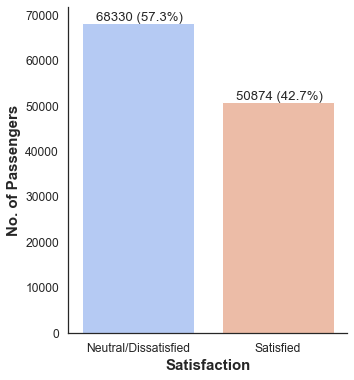

In [28]:
sns.set(style='white',font_scale=1.1)
fig = plt.figure(figsize=[5,6])
ax = sns.countplot(data=df,x='Satisfaction',palette='coolwarm')
ax.set_xticklabels(['Neutral/Dissatisfied','Satisfied'])
for p in ax.patches:
        ax.annotate(str(p.get_height())+' ('+str((p.get_height()/len(df)*100).round(1))+'%)', (p.get_x()+0.1, p.get_height()+400))
plt.xlabel('Satisfaction',weight='bold',fontsize='15')   
plt.ylabel('No. of Passengers',weight='bold',fontsize='15')   
sns.despine()
plt.savefig('targetplot1.png',transparent=True, bbox_inches='tight')

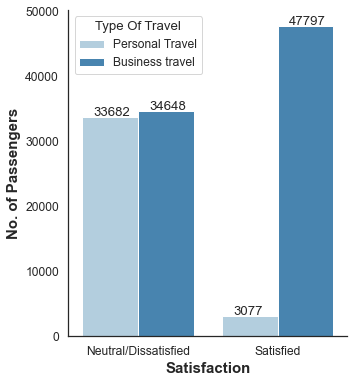

In [29]:
sns.set(style='white',font_scale=1.1)
fig = plt.figure(figsize=[5,6])
ax = sns.countplot(data=df,x='Satisfaction',hue='Type Of Travel',palette='Blues')
ax.set_xticklabels(['Neutral/Dissatisfied','Satisfied'])
for p in ax.patches:
        ax.annotate(p.get_height(), (p.get_x()+0.08, p.get_height()+200))
plt.xlabel('Satisfaction',weight='bold',fontsize='15')   
plt.ylabel('No. of Passengers',weight='bold',fontsize='15')   
sns.despine()
plt.savefig('targetplot2.png',transparent=True, bbox_inches='tight')

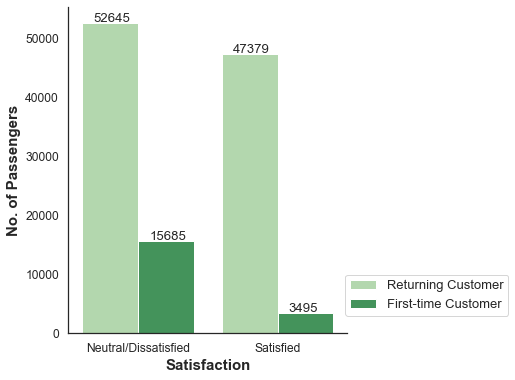

In [30]:
sns.set(style='white',font_scale=1.1)
fig = plt.figure(figsize=[5,6])
ax = sns.countplot(data=df,x='Satisfaction',hue='Customer Type',palette='Greens')
ax.set_xticklabels(['Neutral/Dissatisfied','Satisfied'])
for p in ax.patches:
        ax.annotate(p.get_height(), (p.get_x()+0.08, p.get_height()+200))
plt.xlabel('Satisfaction',weight='bold',fontsize='15')   
plt.ylabel('No. of Passengers',weight='bold',fontsize='15')   
plt.legend(loc="upper right", bbox_to_anchor=(1.6, 0.2),fontsize=13)
sns.despine()
plt.savefig('targetplot3.png',transparent=True, bbox_inches='tight')

<AxesSubplot:ylabel='Satisfaction'>

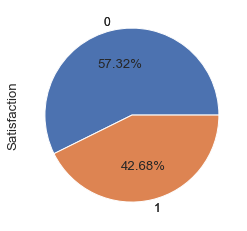

In [31]:
df['Satisfaction'].value_counts().head(10).plot.pie()
import matplotlib.pyplot as plt
plt.gca().set_aspect('equal')
df['Satisfaction'].value_counts().plot(kind='pie',autopct = "%0.2f%%")

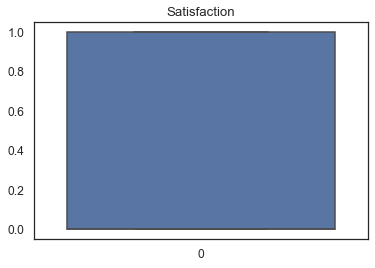

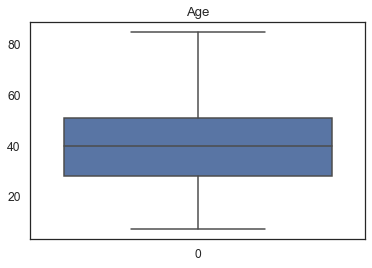

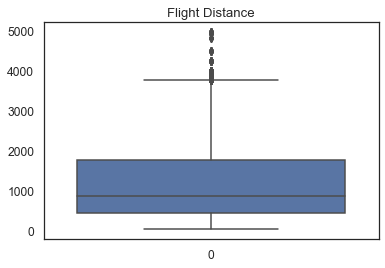

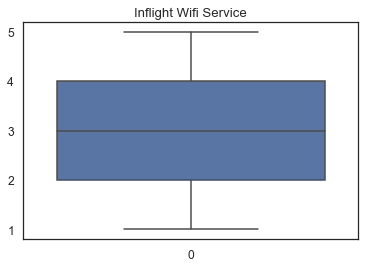

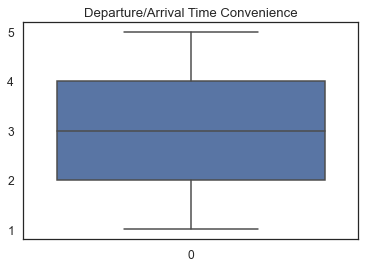

...

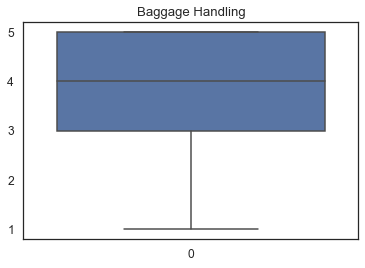

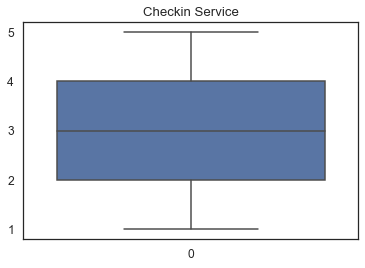

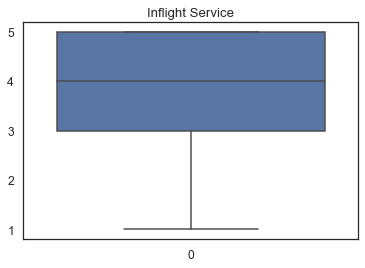

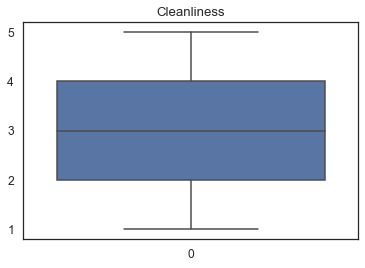

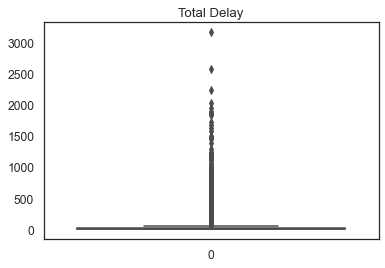

In [32]:
for col in df.select_dtypes(exclude = 'object').keys().to_list():
    sns.boxplot(data = df[col])
    plt.title(col)
    plt.show()

In [33]:
Q1 = np.percentile(df['Flight Distance'], 25,
                   interpolation = 'midpoint')
 
Q3 = np.percentile(df['Flight Distance'], 75,
                   interpolation = 'midpoint')
IQR = Q3 - Q1
 
print("Old Shape: ", df.shape)
 
# Upper bound
upper = np.where(df['Flight Distance'] >= (Q3+1.5*IQR))
# Lower bound
lower = np.where(df['Flight Distance'] <= (Q1-1.5*IQR))
 
''' Removing the Outliers '''
Df = df.copy()
Df.drop(upper[0], inplace = True)
Df.drop(lower[0], inplace = True)
print("New Shape: ", Df.shape)

Old Shape:  (119204, 22)
New Shape:  (116885, 22)


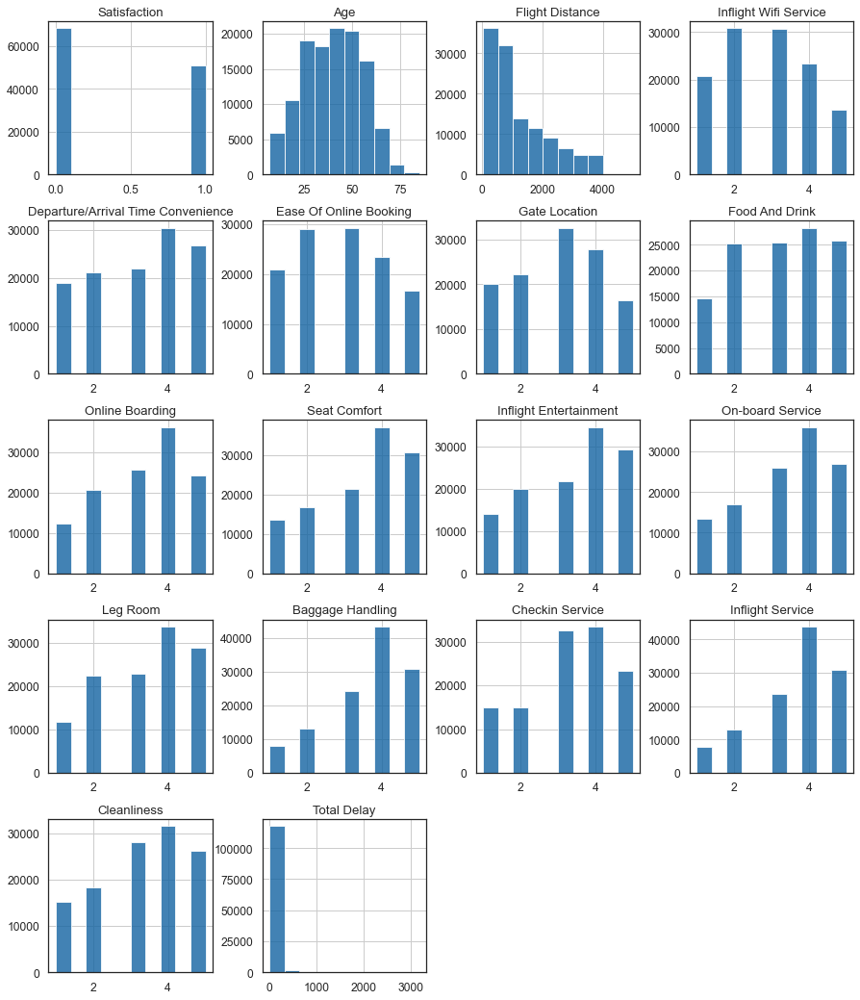

In [34]:
hist = df.hist(figsize = (15, 22), layout=(6, 4) , color='#1363a1',alpha=0.8 )

In [35]:
df1 = pd.get_dummies(df,columns=['Gender','Customer Type','Type Of Travel','Class'],drop_first=True)
df1

,Satisfaction,Age,Flight Distance,Inflight Wifi Service,Departure/Arrival Time Convenience,Ease Of Online Booking,Gate Location,Food And Drink,Online Boarding,Seat Comfort,Inflight Entertainment,On-board Service,Leg Room,Baggage Handling,Checkin Service,Inflight Service,Cleanliness,Total Delay,Gender_Male,Customer Type_Returning Customer,Type Of Travel_Personal Travel,Class_Economy
0,0,13,460,3,4,3,1,5,3,5,5,4,3,4,4,5,5,43.0,1,1,1,1
1,0,25,235,3,2,3,3,1,3,1,1,1,5,3,1,4,1,7.0,1,0,0,0
2,1,26,1142,2,2,2,2,5,5,5,5,4,3,4,4,4,5,0.0,0,1,0,0
3,0,25,562,2,5,5,5,2,2,2,2,2,5,3,1,4,2,20.0,0,1,0,0
4,1,61,214,3,3,3,3,4,5,5,3,3,4,4,3,3,3,0.0,1,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119199,0,34,526,3,3,3,1,4,3,4,4,3,2,4,4,5,4,0.0,1,0,0,0
119200,1,23,646,4,4,4,4,4,4,4,4,4,5,5,5,5,4,0.0,1,1,0,0
119201,0,17,828,2,5,1,5,2,1,2,2,4,3,4,5,4,2,0.0,0,1,1,1
119202,1,14,1127,3,3,3,3,4,4,4,4,3,2,5,4,5,4,0.0,1,1,0,0


In [36]:
df['Inflight Wifi Service'].value_counts()

2    30817
3    30723
4    23420
1    20704
5    13540
Name: Inflight Wifi Service, dtype: int64

In [37]:
group = df1.groupby(['Satisfaction','Class_Economy'])['Class_Economy'].count()
group

Satisfaction  Class_Economy
0             0                18268
              1                50062
1             0                39724
              1                11150
Name: Class_Economy, dtype: int64

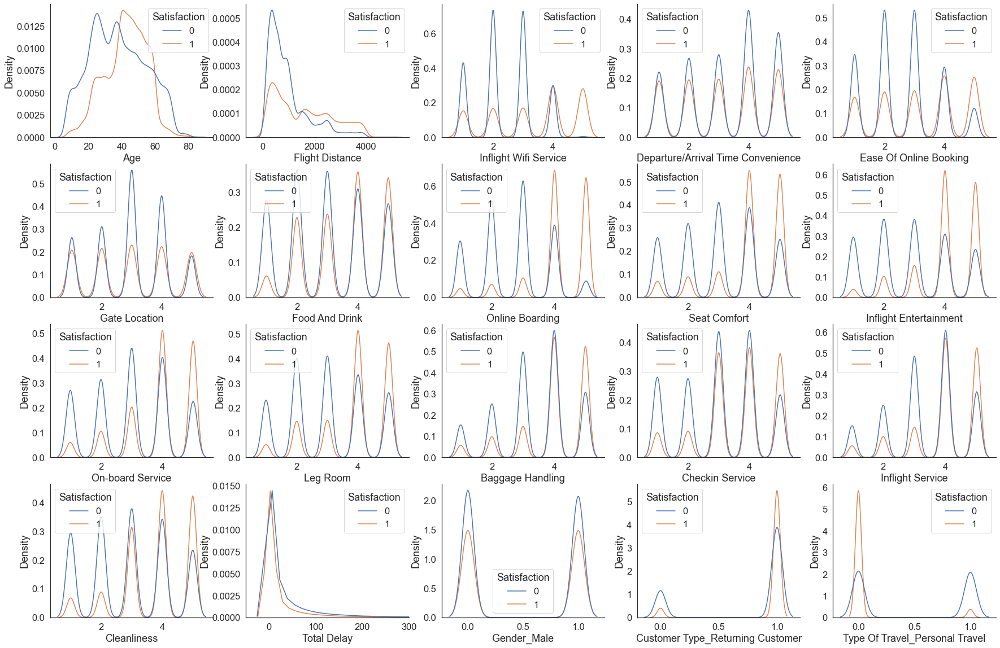

In [38]:
sns.set(style='white',font_scale=1.5)
fig = plt.figure(figsize=[30,20])
for i in range(20):
    fig.add_subplot(4, 5, i+1)
    sns.kdeplot(data=df1,x=df1.columns[i+1],hue='Satisfaction')
    if i == 16:
        plt.xlim([-50,300])
    sns.despine()
    plt.savefig('kdeplot.png',transparent=True, bbox_inches='tight')

In [39]:
df1 = df1.drop('Gender_Male',axis=1)

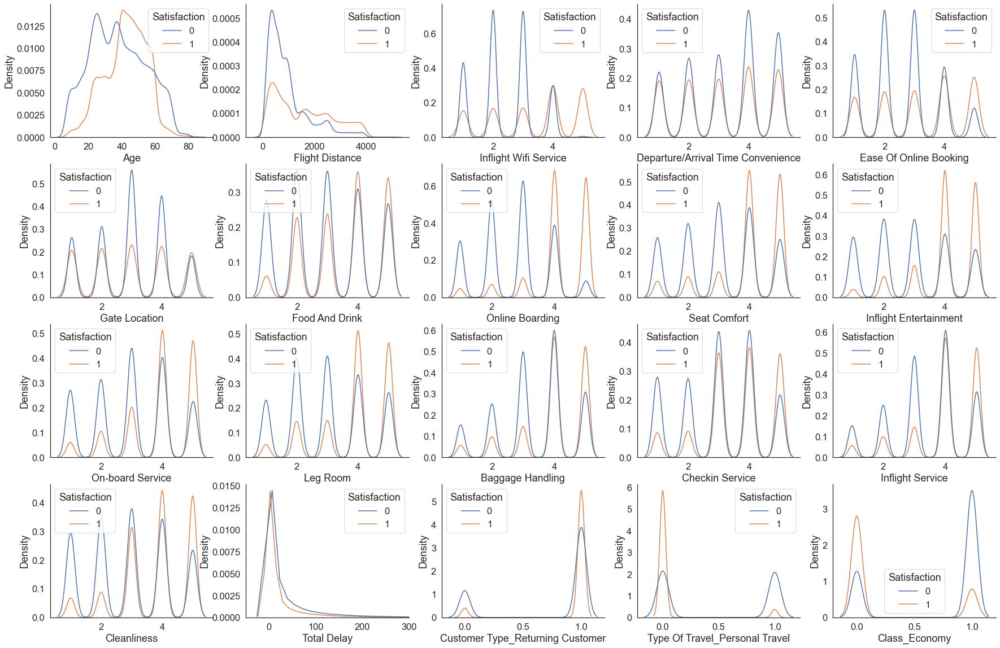

In [40]:
sns.set(style='white',font_scale=1.5)
fig = plt.figure(figsize=[30,20])
for i in range(20):
    fig.add_subplot(4, 5, i+1)
    sns.kdeplot(data=df1,x=df1.columns[i+1],hue='Satisfaction')
    if i == 16:
        plt.xlim([-50,300])
    sns.despine()

In [41]:
corr_matrix = df1.corr()
corr_matrix

,Satisfaction,Age,Flight Distance,Inflight Wifi Service,Departure/Arrival Time Convenience,Ease Of Online Booking,Gate Location,Food And Drink,Online Boarding,Seat Comfort,Inflight Entertainment,On-board Service,Leg Room,Baggage Handling,Checkin Service,Inflight Service,Cleanliness,Total Delay,Customer Type_Returning Customer,Type Of Travel_Personal Travel,Class_Economy
Satisfaction,1.000000,0.152868,0.307337,0.373656,-0.058489,0.227903,0.001269,0.227690,0.569836,0.374360,0.438072,0.348820,0.344192,0.273304,0.245044,0.268287,0.330021,-0.055244,0.216518,-0.463153,-0.508131
Age,0.152868,1.000000,0.082924,0.021448,-0.013146,0.024822,-0.004988,0.018803,0.188926,0.154448,0.075043,0.069765,0.054949,-0.036371,0.042475,-0.041001,0.046800,-0.013694,0.253203,-0.063790,-0.139443
Flight Distance,0.307337,0.082924,1.000000,0.011156,-0.072517,0.056509,0.003399,0.057448,0.199607,0.157162,0.134219,0.121413,0.137907,0.074428,0.080950,0.068757,0.096142,-0.001778,0.205168,-0.275522,-0.468642
Inflight Wifi Service,0.373656,0.021448,0.011156,1.000000,0.390480,0.675683,0.381499,0.150506,0.454252,0.146984,0.227293,0.126861,0.158815,0.118729,0.058326,0.108618,0.155612,-0.026637,0.018024,-0.125507,-0.047822
Departure/Arrival Time Convenience,-0.058489,-0.013146,-0.072517,0.390480,1.000000,0.516740,0.523515,-0.008600,0.058801,-0.012130,-0.033349,0.077686,-0.002820,0.081554,0.117566,0.083479,0.001624,-0.006771,0.103268,0.258886,0.124007
Ease Of Online Booking,0.227903,0.024822,0.056509,0.675683,0.516740,1.000000,0.529088,0.028843,0.351209,0.033272,0.036035,0.032335,0.085435,0.023292,0.017118,0.022017,0.017683,-0.013617,0.035843,-0.130480,-0.115816
Gate Location,0.001269,-0.004988,0.003399,0.381499,0.523515,0.529088,1.000000,-0.002761,-0.001075,0.002285,0.002275,-0.029213,-0.005401,0.002979,-0.039429,0.001264,-0.005563,0.004919,-0.010853,-0.032544,-0.005474
Food And Drink,0.227690,0.018803,0.057448,0.150506,-0.008600,0.028843,-0.002761,1.000000,0.259212,0.570293,0.614637,0.063149,0.037163,0.039335,0.090482,0.040009,0.646661,-0.025685,0.056600,-0.072232,-0.092753
Online Boarding,0.569836,0.188926,0.199607,0.454252,0.058801,0.351209,-0.001075,0.259212,1.000000,0.450327,0.316159,0.177231,0.141835,0.105080,0.228185,0.095040,0.360166,-0.032719,0.189204,-0.222706,-0.328193
Seat Comfort,0.374360,0.154448,0.157162,0.146984,-0.012130,0.033272,0.002285,0.570293,0.450327,1.000000,0.614251,0.145257,0.117560,0.087874,0.199152,0.082752,0.676200,-0.031682,0.151855,-0.136871,-0.241498


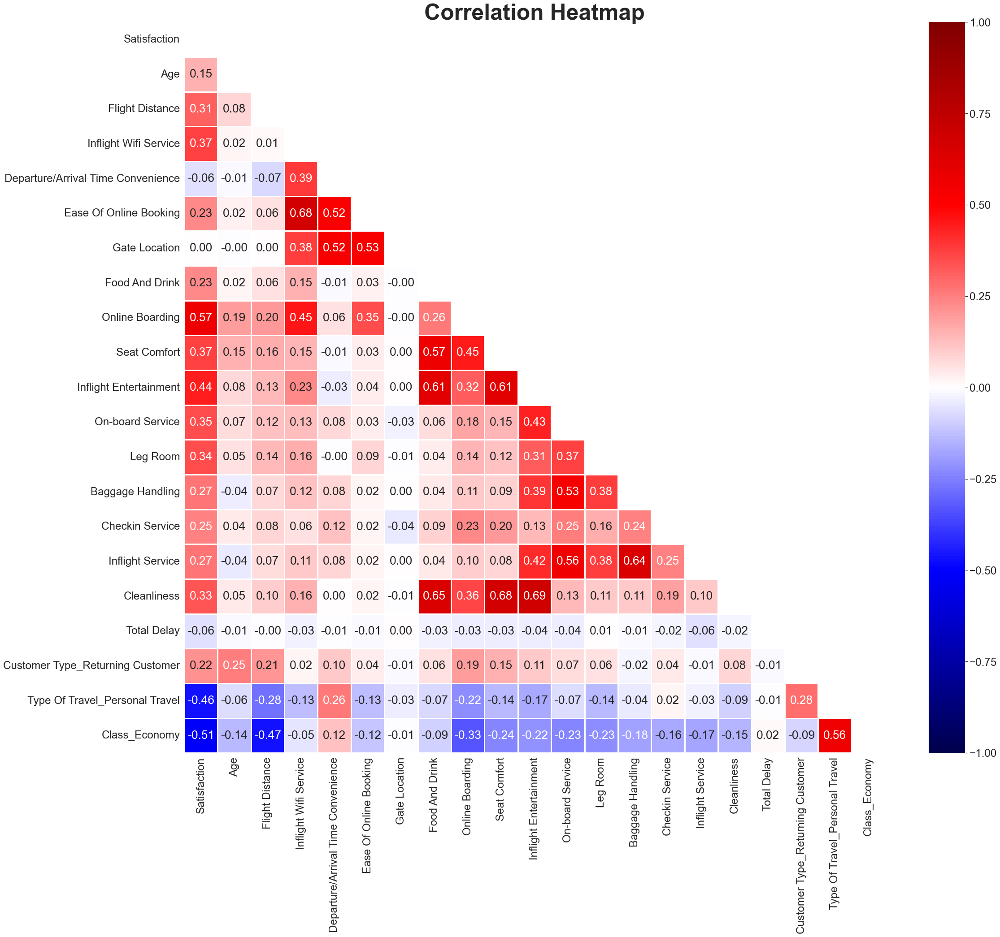

In [42]:
sns.set(style='white',font_scale=2.2)
fig = plt.figure(figsize=[35,30])
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))
cmap = sns.diverging_palette(150, 0, as_cmap=True)
sns.heatmap(corr_matrix,cmap='seismic',linewidth=3,linecolor='white',vmax = 1, vmin=-1,mask=mask, annot=True,fmt='0.2f')
plt.title('Correlation Heatmap', weight='bold',fontsize=50)
plt.savefig('heatmap.png',transparent=True, bbox_inches='tight')

In [43]:
y = df1['Satisfaction']
X = df1.drop('Satisfaction',axis=1)

In [44]:
std = StandardScaler()
std.fit(X.values)
X_tr = std.transform(X.values)

In [45]:
lasso_model = Lasso(alpha = 0.01)    
selected_columns = list(X.columns)
lasso_model.fit(X, y)
list(zip(selected_columns, lasso_model.coef_))

[('Age', 0.00020266980936780985),
 ('Flight Distance', 2.711821119127301e-05),
 ('Inflight Wifi Service', 0.06584769645997061),
 ('Departure/Arrival Time Convenience', -0.02386632819889069),
 ('Ease Of Online Booking', -0.0),
 ('Gate Location', -0.004927958351779418),
 ('Food And Drink', -0.0),
 ('Online Boarding', 0.10154244035028799),
 ('Seat Comfort', 0.002473075954784796),
 ('Inflight Entertainment', 0.03154491743624765),
 ('On-board Service', 0.033834467510821184),
 ('Leg Room', 0.03650287366803891),
 ('Baggage Handling', 0.013447558222812822),
 ('Checkin Service', 0.029358385411125426),
 ('Inflight Service', 0.009424193990272903),
 ('Cleanliness', 0.013875170954060509),
 ('Total Delay', -0.00020646211246318363),
 ('Customer Type_Returning Customer', 0.19061432107186024),
 ('Type Of Travel_Personal Travel', -0.2772050441414631),
 ('Class_Economy', -0.09158830522110929)]

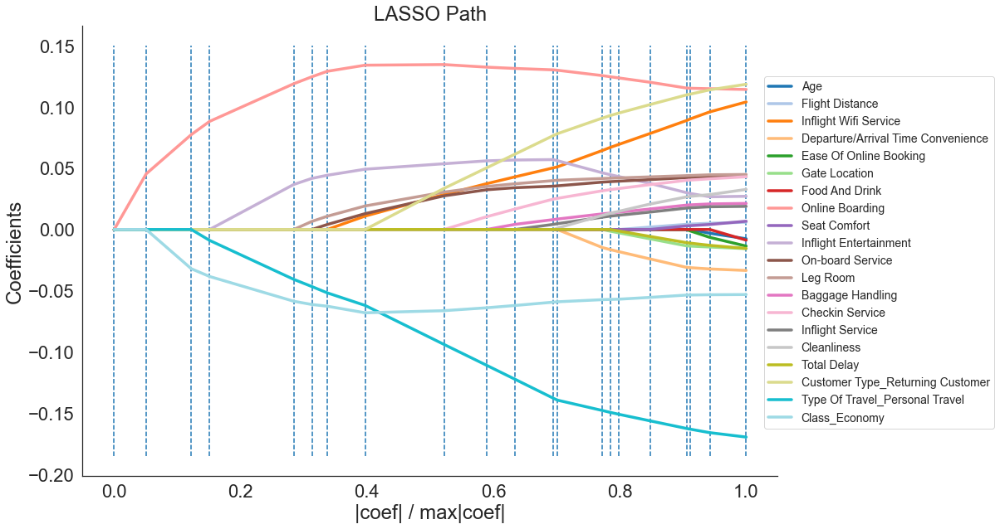

In [46]:
alphas, _, coefs = lars_path(X_tr, y.values, method='lasso')

from cycler import cycler

# plotting the LARS path
sns.set(style='white',font_scale=2)
xx = np.sum(np.abs(coefs.T), axis=1)
xx /= xx[-1]

plt.rc('axes', prop_cycle =(cycler(color =['#1F77B4', '#AEC7E8', '#FF7F0E', '#FFBB78', '#2CA02C', '#98DF8A',
                                            '#D62728', '#FF9896', '#9467BD', '#C5B0D5', '#8C564B', '#C49C94',
                                            '#E377C2', '#F7B6D2', '#7F7F7F', '#C7C7C7', '#BCBD22', '#DBDB8D',
                                            '#17BECF', '#9EDAE5'])))

plt.figure(figsize=(15,10))
plt.plot(xx, coefs.T,linewidth=3.5)

ymin, ymax = plt.ylim()
plt.vlines(xx, ymin, ymax, linestyle='dashed')
plt.xlabel('|coef| / max|coef|')
plt.ylabel('Coefficients')
plt.title('LASSO Path')
plt.axis('tight')
plt.legend(X.columns,loc="upper right", bbox_to_anchor=(1.32, 0.9),fontsize=14)
sns.despine()
plt.savefig('lassoplot.png',transparent=True, bbox_inches='tight')

In [47]:
df1 = df1.drop(['Total Delay','Flight Distance','Age','Gate Location','Departure/Arrival Time Convenience'],axis=1)

# Model Selection

In [48]:
y = df1['Satisfaction']
X = df1.drop('Satisfaction',axis=1)

In [49]:
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2,random_state=42)
kf = KFold(n_splits=5, shuffle=True, random_state = 71)

In [50]:
Cvec = np.linspace(0.001,2,100)
logit_model = LogisticRegressionCV(Cs = Cvec, cv=kf,max_iter=10000)
logit_model.fit(X_train_val, y_train_val)
logit_model.C_

array([0.12215152])

In [51]:
logit_model = LogisticRegression(C=logit_model.C_[0],max_iter=10000)
Mean_AUC_Logit_CV = np.mean(cross_val_score(logit_model, X_train_val, y_train_val, cv=kf, scoring='roc_auc'))
Mean_AUC_Logit_CV 

0.9585309005959747

In [52]:
Mean_Precision_Logit_CV = np.mean(cross_val_score(logit_model, X_train_val, y_train_val, cv=kf, scoring='precision'))
Mean_Precision_Logit_CV 

0.8807289379439572

In [53]:
Mean_Recall_Logit_CV = np.mean(cross_val_score(logit_model, X_train_val, y_train_val, cv=kf, scoring='recall'))
Mean_Recall_Logit_CV 

0.8700179529818459

In [54]:
X_train_val = X_train_val.reset_index().drop('index',axis=1)
y_train_val = y_train_val.reset_index().drop('index',axis=1)

In [55]:
Mean_AUC_KNN_CV = np.mean(cross_val_score(KNeighborsClassifier(n_neighbors=7), X_train_val, y_train_val, cv=kf, scoring='roc_auc'))
Mean_AUC_KNN_CV 

0.9783417865674545

In [56]:
Mean_Precision_KNN_CV = np.mean(cross_val_score(KNeighborsClassifier(n_neighbors=7), X_train_val, y_train_val, cv=kf, scoring='precision'))
Mean_Precision_KNN_CV 

0.9503019730916019

In [57]:
Mean_Recall_KNN_CV = np.mean(cross_val_score(KNeighborsClassifier(n_neighbors=7), X_train_val, y_train_val, cv=kf, scoring='recall'))
Mean_Recall_KNN_CV 

0.9036422422235884

In [58]:
Mean_AUC_NB_CV = np.mean(cross_val_score(GaussianNB(), X_train_val, y_train_val, cv=kf, scoring='roc_auc'))
Mean_AUC_NB_CV 

0.9460878182059076

In [59]:
Mean_Precision_NB_CV = np.mean(cross_val_score(GaussianNB(), X_train_val, y_train_val, cv=kf, scoring='precision'))
Mean_Precision_NB_CV 

0.8921853166617819

In [60]:
Mean_Recall_NB_CV = np.mean(cross_val_score(GaussianNB(), X_train_val, y_train_val, cv=kf, scoring='recall'))
Mean_Recall_NB_CV

0.8387531920649355

In [61]:
Mean_AUC_tree_CV = np.mean(cross_val_score(DecisionTreeClassifier(max_depth=12), X_train_val, y_train_val, cv=kf, scoring='roc_auc'))
Mean_AUC_tree_CV 

0.9817045550153543

In [62]:
Mean_Precision_tree_CV = np.mean(cross_val_score(DecisionTreeClassifier(max_depth=12), X_train_val, y_train_val, cv=kf, scoring='precision'))
Mean_Precision_tree_CV 

0.9636669218187723

In [63]:
Mean_Recall_tree_CV = np.mean(cross_val_score(DecisionTreeClassifier(max_depth=12), X_train_val, y_train_val, cv=kf, scoring='recall'))
Mean_Recall_tree_CV

0.9202768257986655

In [64]:
Mean_AUC_forest_CV = np.mean(cross_val_score(RandomForestClassifier(max_depth=17,random_state=42), X_train_val, y_train_val, cv=kf, scoring='roc_auc'))
Mean_AUC_forest_CV

0.9925499162519437

In [65]:
Mean_Precision_forest_CV = np.mean(cross_val_score(RandomForestClassifier(max_depth=17,random_state=42), X_train_val, y_train_val, cv=kf, scoring='precision'))
Mean_Precision_forest_CV

0.9686272921300034

In [66]:
Mean_Recall_forest_CV = np.mean(cross_val_score(RandomForestClassifier(max_depth=17,random_state=42), X_train_val, y_train_val, cv=kf, scoring='recall'))
Mean_Recall_forest_CV

0.9335443428595436

In [67]:
Log_Model = LogisticRegression(C=0.04138384,max_iter=10000)
KNN_Model = KNeighborsClassifier(n_neighbors=7)
NB_Model = GaussianNB()
Tree_Model = DecisionTreeClassifier(max_depth=12)
Forest_Model = RandomForestClassifier(max_depth=17,random_state=42)

model_list = [Log_Model,KNN_Model,NB_Model,Tree_Model,Forest_Model]
model_names = ["log_model", "knn_model", "nb_model", "tree_model", "forest_model"]
model = list(zip(model_names, model_list))

In [68]:
Mean_AUC_ensemble_CV = np.mean(cross_val_score(VotingClassifier(estimators=model,voting='soft',n_jobs=-1), X_train_val, y_train_val, cv=kf, scoring='roc_auc'))
Mean_AUC_ensemble_CV

0.9875140782598504

In [69]:
Mean_Precision_ensemble_CV = np.mean(cross_val_score(VotingClassifier(estimators=model,voting='soft',n_jobs=-1), X_train_val, y_train_val, cv=kf, scoring='precision'))
Mean_Precision_ensemble_CV

0.9537170585757938

In [70]:
Mean_Recall_ensemble_CV = np.mean(cross_val_score(VotingClassifier(estimators=model,voting='soft',n_jobs=-1), X_train_val, y_train_val, cv=kf, scoring='recall'))
Mean_Recall_ensemble_CV

0.9163369375283675

In [71]:
model = ['Logistic Regression','KNN','Gaussian NB','Decision Trees','Random Forest','Ensemble']
scoring = ['AUC','Precision','Recall']
model_name = ['Logit','KNN','NB','tree','forest','ensemble']
model_list = []

for i in model:
    for j in scoring:
        model_dic = {'Model': i,'Scoring':j, 'Score':eval('Mean_{0}_{1}_CV'.format(j,model_name[model.index(i)]))}
        model_list.append(model_dic)

In [72]:
model_df = pd.DataFrame(model_list)
model_df

,Model,Scoring,Score
0,Logistic Regression,AUC,0.958531
1,Logistic Regression,Precision,0.880729
2,Logistic Regression,Recall,0.870018
3,KNN,AUC,0.978342
4,KNN,Precision,0.950302
5,KNN,Recall,0.903642
6,Gaussian NB,AUC,0.946088
7,Gaussian NB,Precision,0.892185
8,Gaussian NB,Recall,0.838753
9,Decision Trees,AUC,0.981705


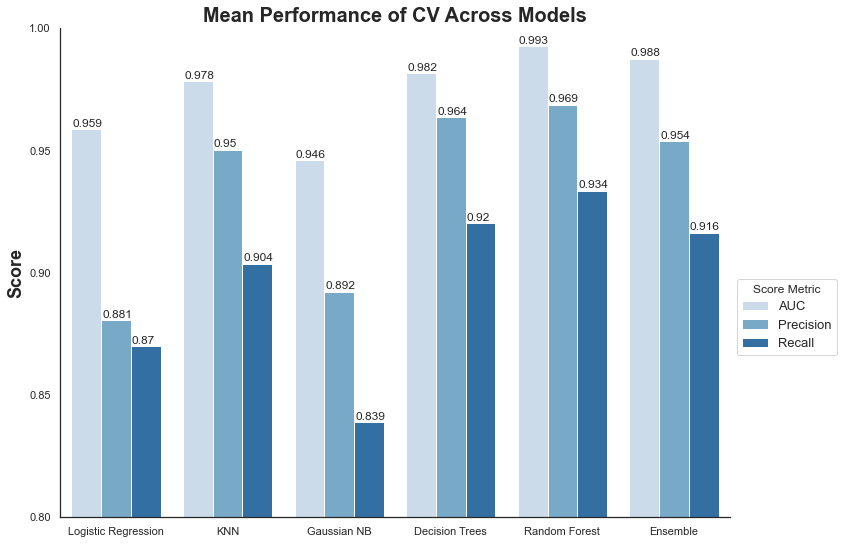

In [73]:
sns.set(style='white',font_scale=1)
fig = plt.figure(figsize=[12,9])
ax = sns.barplot(x='Model',y='Score',data=model_df,hue='Scoring',palette='Blues')
for p in ax.patches:
        ax.annotate(p.get_height().round(3), (p.get_x()+0.01, p.get_height()+0.001))
plt.legend(title='Score Metric',loc="upper right", bbox_to_anchor=(1.17, 0.5),fontsize=13)
plt.ylim([0.8,1.0])
plt.yticks([0.80,0.85,0.90,0.95,1.00])
plt.xlabel('',weight='bold',fontsize='15')
plt.ylabel('Score',weight='bold',fontsize='18')
plt.title('Mean Performance of CV Across Models',weight='bold',fontsize=20)
sns.despine()
plt.savefig('modelbarplot.png',transparent=True, bbox_inches='tight')

In [74]:
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=0.25,random_state=42)

In [75]:
rf = RandomForestClassifier(max_depth=17, random_state=42)
rf.fit(X_train,y_train)
print("Random Forest score: {:.4f}".format(rf.score(X_train,y_train)))

Random Forest score: 0.9790


In [76]:
y_predict = rf.predict_proba(X_val)[:, 1] >= 0.5
precision_05 = precision_score(y_val, y_predict)
precision_05

0.9723092470944922

In [77]:
recall_05=recall_score(y_val, y_predict)
recall_05

0.9356219002236701

In [78]:
rf = RandomForestClassifier(max_depth=17,random_state=42)
rf.fit(X_train_val,y_train_val)
print("Random Forest score: {:.4f}".format(rf.score(X_train_val,y_train_val)))

Random Forest score: 0.9778


In [79]:
def make_confusion_matrix(model, threshold=0.7):
    # Predict class 1 if probability of being in class 1 is greater than threshold
    # (model.predict(X_test) does this automatically with a threshold of 0.5)
    y_predict = (model.predict_proba(X_test)[:, 1] >= threshold)
    satisfaction_confusion = confusion_matrix(y_test, y_predict)
    plt.figure(dpi=120)
    ax = sns.heatmap(satisfaction_confusion, cmap=plt.cm.Blues, annot=True, square=True, fmt='d',
           xticklabels=['Neutral/Dissatisfied', 'Satisfied'],
           yticklabels=['Neutral/Dissatisfied', 'Satisfied']);   
    plt.xlabel('Prediction',weight='bold',fontsize=12)
    plt.ylabel('Actual',weight='bold',fontsize=12)
    plt.title('Confusion Matrix',weight='bold',fontsize=15)

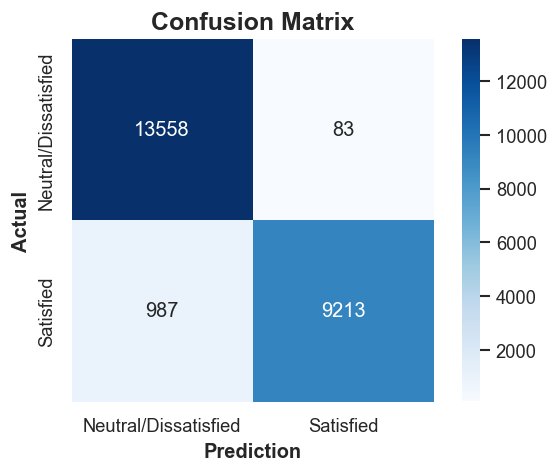

In [80]:
sns.set(style='white',font_scale=1)
make_confusion_matrix(rf)
plt.savefig('confusionplot.png',transparent=True, bbox_inches='tight')

In [81]:
y_predict = rf.predict_proba(X_test)[:, 1]>=0.7
precision_score(y_test, y_predict)

0.9910714285714286

In [82]:
recall_score(y_test, y_predict)

0.903235294117647

In [83]:
f1_score(y_test, y_predict)

0.9451169470660649

In [84]:
roc_auc_score(y_test, rf.predict_proba(X_test)[:, 1])

0.993279207291743

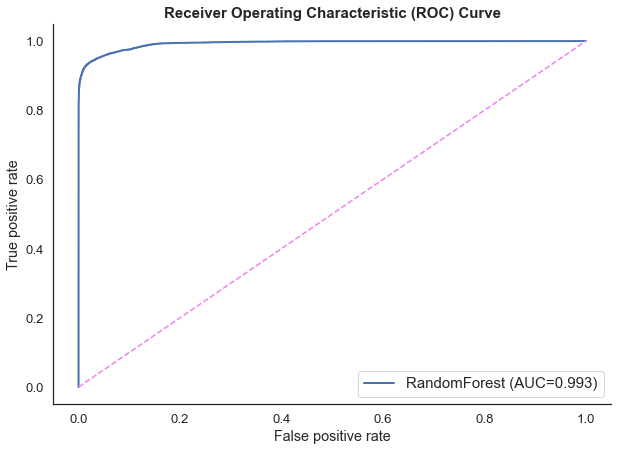

In [85]:
fpr, tpr, thresholds = roc_curve(y_test, rf.predict_proba(X_test)[:,1])
sns.set(style='white',font_scale=1.2)
fig = plt.figure(figsize=[10,7])
plt.plot(fpr, tpr,lw=2,label='RandomForest (AUC={:.3f})'.format(roc_auc_score(y_test, rf.predict_proba(X_test)[:,1])))
plt.plot([0,1],[0,1],c='violet',ls='--')
plt.xlim([-0.05,1.05])
plt.ylim([-0.05,1.05])
plt.legend(loc="lower right",fontsize=15)

plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('Receiver Operating Characteristic (ROC) Curve',weight='bold',fontsize=15);
sns.despine()
plt.savefig('ROCplot.png',transparent=True, bbox_inches='tight')

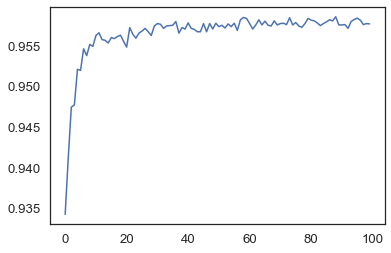

In [86]:
import numpy as np
%matplotlib inline
from sklearn.metrics import accuracy_score
trees=range(100)
accuracy=np.zeros(100)

for i in range(len(trees)):
    clf = RandomForestClassifier(n_estimators = i+1)
    model1 = clf.fit(X_train, y_train)
    y_predictions = model1.predict(X_val)
    accuracy[i] = accuracy_score(y_val, y_predictions)

plt.plot(trees,accuracy)

In [87]:
rf.feature_importances_

array([0.13335003, 0.03359042, 0.01419902, 0.18277554, 0.06135442,
       0.07549751, 0.03518382, 0.0497273 , 0.03226949, 0.02755655,
       0.02654352, 0.03165819, 0.05199891, 0.12638954, 0.11790574])

In [88]:
df_impt = pd.DataFrame({'features':X_train_val.columns,'importance':rf.feature_importances_})
df_impt = df_impt.sort_values(by='importance',ascending=True)
df_impt

,features,importance
2,Food And Drink,0.014199
10,Inflight Service,0.026544
9,Checkin Service,0.027557
11,Cleanliness,0.031658
8,Baggage Handling,0.032269
1,Ease Of Online Booking,0.033590
6,On-board Service,0.035184
7,Leg Room,0.049727
12,Customer Type_Returning Customer,0.051999
4,Seat Comfort,0.061354


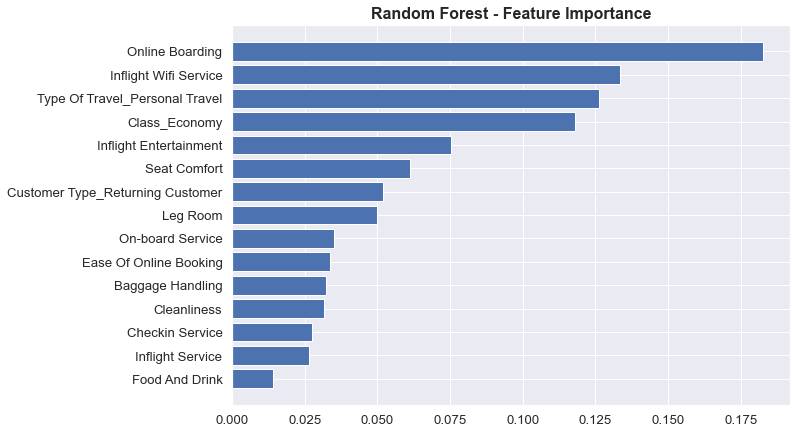

In [89]:
sns.set(style='darkgrid',font_scale=1.2)
fig = plt.figure(figsize=[10,7])
ax = plt.barh(df_impt['features'],df_impt['importance'])
plt.title('Random Forest - Feature Importance',weight='bold',fontsize=16)
plt.savefig('featureplot.png',transparent=True, bbox_inches='tight')

In [90]:
Test_Set = pd.DataFrame(y_test).join(X_test).join(pd.DataFrame(DF['Id']))
Test_Set['Predicted Satisfaction'] = (rf.predict_proba(X_test)[:, 1]>=0.7).astype(int)
Test_Set = Test_Set[['Satisfaction','Predicted Satisfaction','Inflight Wifi Service','Ease Of Online Booking','Food And Drink','Online Boarding','Seat Comfort','Inflight Entertainment','On-board Service','Leg Room','Baggage Handling','Checkin Service','Inflight Service','Cleanliness','Customer Type_Returning Customer','Type Of Travel_Personal Travel','Class_Economy']]
Test_Set.reset_index(inplace=True)
Test_Set.drop('index',axis=1,inplace=True)
Test_Set['Satisfaction'] = Test_Set['Satisfaction'].map({0:'Neutral/Dissatisfied',1:'Satisfied'})
Test_Set['Predicted Satisfaction'] = Test_Set['Predicted Satisfaction'].map({0:'Neutral/Dissatisfied',1:'Satisfied'})
Test_Set

,Satisfaction,Predicted Satisfaction,Inflight Wifi Service,Ease Of Online Booking,Food And Drink,Online Boarding,Seat Comfort,Inflight Entertainment,On-board Service,Leg Room,Baggage Handling,Checkin Service,Inflight Service,Cleanliness,Customer Type_Returning Customer,Type Of Travel_Personal Travel,Class_Economy
0,Satisfied,Neutral/Dissatisfied,2,3,1,5,4,2,2,2,2,3,2,3,1,0,1
1,Neutral/Dissatisfied,Neutral/Dissatisfied,2,2,2,2,2,2,2,1,2,2,2,2,1,0,1
2,Satisfied,Satisfied,4,2,4,4,4,4,5,3,1,3,2,4,1,0,1
3,Satisfied,Satisfied,4,3,5,5,5,5,1,4,1,5,4,5,1,0,0
4,Neutral/Dissatisfied,Neutral/Dissatisfied,3,3,2,3,2,2,3,1,4,4,3,2,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23836,Neutral/Dissatisfied,Neutral/Dissatisfied,3,3,1,3,1,1,3,4,2,4,1,1,0,0,1
23837,Satisfied,Satisfied,4,4,4,4,4,4,4,5,4,5,5,4,1,0,0
23838,Satisfied,Satisfied,5,2,5,5,5,5,1,4,4,1,1,5,1,0,1
23839,Neutral/Dissatisfied,Neutral/Dissatisfied,3,3,5,3,5,5,2,5,4,3,3,5,0,0,1


In [91]:
Test_Set[(Test_Set['Class_Economy']==0)&(Test_Set['Satisfaction']=='Satisfied')&(Test_Set['Type Of Travel_Personal Travel']==0)&((Test_Set['Inflight Wifi Service']!=5))].head(100)

,Satisfaction,Predicted Satisfaction,Inflight Wifi Service,Ease Of Online Booking,Food And Drink,Online Boarding,Seat Comfort,Inflight Entertainment,On-board Service,Leg Room,Baggage Handling,Checkin Service,Inflight Service,Cleanliness,Customer Type_Returning Customer,Type Of Travel_Personal Travel,Class_Economy
3,Satisfied,Satisfied,4,3,5,5,5,5,1,4,1,5,4,5,1,0,0
7,Satisfied,Satisfied,2,2,1,4,5,5,5,4,5,5,5,1,1,0,0
11,Satisfied,Satisfied,4,4,3,5,4,4,4,4,4,3,4,4,1,0,0
12,Satisfied,Satisfied,3,3,5,5,5,5,3,3,5,3,5,5,1,0,0
16,Satisfied,Satisfied,3,3,4,5,4,5,5,5,5,5,5,4,1,0,0
19,Satisfied,Satisfied,4,5,3,4,5,4,4,4,4,5,4,4,1,0,0
20,Satisfied,Satisfied,1,1,4,2,4,4,4,4,4,5,4,4,1,0,0
21,Satisfied,Satisfied,2,2,5,5,5,5,2,4,5,2,2,5,1,0,0
22,Satisfied,Satisfied,2,2,5,5,5,4,4,4,4,4,4,3,1,0,0
23,Satisfied,Satisfied,4,4,5,4,5,4,4,4,4,3,4,5,1,0,0


In [92]:
Test_Set_Economy = Test_Set[(Test_Set['Class_Economy']==1)&(Test_Set['Type Of Travel_Personal Travel']==1)&(Test_Set['Customer Type_Returning Customer']==0)]
Test_Set_Economy['Satisfaction'] = Test_Set_Economy['Satisfaction'].map({'Neutral/Dissatisfied':0,'Satisfied':1})
Test_Set_Economy['Predicted Satisfaction'] = Test_Set_Economy['Predicted Satisfaction'].map({'Neutral/Dissatisfied':0,'Satisfied':1})
precision_score(Test_Set_Economy['Satisfaction'], Test_Set_Economy['Predicted Satisfaction'])

1.0

In [93]:
## NEW ECONOMY (Personal Travel) CUSTOMERS ##
neweconomy = []
neweconomy.append({'Inflight Wifi Service':3,'Ease Of Online Booking':3,'Food And Drink':3,'Online Boarding':3,'Seat Comfort':3,'Inflight Entertainment':3,'On-board Service':3,'Leg Room':3,'Baggage Handling':3,'Checkin Service':3,'Inflight Service':3,'Cleanliness':3,'Customer Type_Returning Customer':0,'Type Of Travel_Personal Travel':1,'Class_Economy':1})     
neweconomy.append({'Inflight Wifi Service':5,'Ease Of Online Booking':3,'Food And Drink':3,'Online Boarding':3,'Seat Comfort':3,'Inflight Entertainment':3,'On-board Service':3,'Leg Room':3,'Baggage Handling':3,'Checkin Service':3,'Inflight Service':3,'Cleanliness':3,'Customer Type_Returning Customer':0,'Type Of Travel_Personal Travel':1,'Class_Economy':1})
neweconomy.append({'Inflight Wifi Service':4,'Ease Of Online Booking':5,'Food And Drink':5,'Online Boarding':5,'Seat Comfort':5,'Inflight Entertainment':5,'On-board Service':5,'Leg Room':5,'Baggage Handling':5,'Checkin Service':5,'Inflight Service':5,'Cleanliness':5,'Customer Type_Returning Customer':0,'Type Of Travel_Personal Travel':1,'Class_Economy':1})
neweconomy.append({'Inflight Wifi Service':3,'Ease Of Online Booking':5,'Food And Drink':5,'Online Boarding':5,'Seat Comfort':5,'Inflight Entertainment':5,'On-board Service':5,'Leg Room':5,'Baggage Handling':5,'Checkin Service':5,'Inflight Service':5,'Cleanliness':5,'Customer Type_Returning Customer':0,'Type Of Travel_Personal Travel':1,'Class_Economy':1}) 
neweconomy = pd.DataFrame(neweconomy)

In [94]:
neweconomy['Predicted Satisfaction'] = (rf.predict_proba(neweconomy)[:, 1]>=0.7).astype(int)
neweconomy = neweconomy[['Predicted Satisfaction','Inflight Wifi Service','Ease Of Online Booking','Food And Drink','Online Boarding','Seat Comfort','Inflight Entertainment','On-board Service','Leg Room','Baggage Handling','Checkin Service','Inflight Service','Cleanliness','Customer Type_Returning Customer','Type Of Travel_Personal Travel','Class_Economy']]
neweconomy['Predicted Satisfaction'] = neweconomy['Predicted Satisfaction'].map({0:'Neutral/Dissatisfied',1:'Satisfied'})
neweconomy

,Predicted Satisfaction,Inflight Wifi Service,Ease Of Online Booking,Food And Drink,Online Boarding,Seat Comfort,Inflight Entertainment,On-board Service,Leg Room,Baggage Handling,Checkin Service,Inflight Service,Cleanliness,Customer Type_Returning Customer,Type Of Travel_Personal Travel,Class_Economy
0,Neutral/Dissatisfied,3,3,3,3,3,3,3,3,3,3,3,3,0,1,1
1,Satisfied,5,3,3,3,3,3,3,3,3,3,3,3,0,1,1
2,Neutral/Dissatisfied,4,5,5,5,5,5,5,5,5,5,5,5,0,1,1
3,Neutral/Dissatisfied,3,5,5,5,5,5,5,5,5,5,5,5,0,1,1


In [95]:
Test_Set_Business = Test_Set[(Test_Set['Class_Economy']==0)&(Test_Set['Type Of Travel_Personal Travel']==0)&(Test_Set['Customer Type_Returning Customer']==0)]
Test_Set_Business['Satisfaction'] = Test_Set_Business['Satisfaction'].map({'Neutral/Dissatisfied':0,'Satisfied':1})
Test_Set_Business['Predicted Satisfaction'] = Test_Set_Business['Predicted Satisfaction'].map({'Neutral/Dissatisfied':0,'Satisfied':1})
precision_score(Test_Set_Business['Satisfaction'], Test_Set_Business['Predicted Satisfaction'])

0.9083333333333333

In [96]:
## NEW Business (Business Travel) CUSTOMERS ##
newbusiness = []
newbusiness.append({'Inflight Wifi Service':3,'Ease Of Online Booking':3,'Food And Drink':3,'Online Boarding':3,'Seat Comfort':3,'Inflight Entertainment':3,'On-board Service':3,'Leg Room':3,'Baggage Handling':3,'Checkin Service':3,'Inflight Service':3,'Cleanliness':3,'Customer Type_Returning Customer':0,'Type Of Travel_Personal Travel':0,'Class_Economy':0})     
newbusiness.append({'Inflight Wifi Service':5,'Ease Of Online Booking':3,'Food And Drink':3,'Online Boarding':3,'Seat Comfort':3,'Inflight Entertainment':3,'On-board Service':3,'Leg Room':3,'Baggage Handling':3,'Checkin Service':3,'Inflight Service':3,'Cleanliness':3,'Customer Type_Returning Customer':0,'Type Of Travel_Personal Travel':0,'Class_Economy':0})
newbusiness.append({'Inflight Wifi Service':3,'Ease Of Online Booking':5,'Food And Drink':5,'Online Boarding':5,'Seat Comfort':5,'Inflight Entertainment':5,'On-board Service':5,'Leg Room':5,'Baggage Handling':5,'Checkin Service':5,'Inflight Service':5,'Cleanliness':5,'Customer Type_Returning Customer':0,'Type Of Travel_Personal Travel':0,'Class_Economy':0})
newbusiness.append({'Inflight Wifi Service':3,'Ease Of Online Booking':4,'Food And Drink':4,'Online Boarding':4,'Seat Comfort':4,'Inflight Entertainment':4,'On-board Service':4,'Leg Room':4,'Baggage Handling':4,'Checkin Service':4,'Inflight Service':4,'Cleanliness':4,'Customer Type_Returning Customer':0,'Type Of Travel_Personal Travel':0,'Class_Economy':0})
newbusiness.append({'Inflight Wifi Service':3,'Ease Of Online Booking':5,'Food And Drink':4,'Online Boarding':4,'Seat Comfort':4,'Inflight Entertainment':4,'On-board Service':4,'Leg Room':4,'Baggage Handling':4,'Checkin Service':4,'Inflight Service':4,'Cleanliness':4,'Customer Type_Returning Customer':0,'Type Of Travel_Personal Travel':0,'Class_Economy':0})
newbusiness.append({'Inflight Wifi Service':3,'Ease Of Online Booking':4,'Food And Drink':5,'Online Boarding':5,'Seat Comfort':5,'Inflight Entertainment':5,'On-board Service':5,'Leg Room':5,'Baggage Handling':5,'Checkin Service':5,'Inflight Service':5,'Cleanliness':5,'Customer Type_Returning Customer':0,'Type Of Travel_Personal Travel':0,'Class_Economy':0})
newbusiness = pd.DataFrame(newbusiness)

In [97]:
newbusiness['Predicted Satisfaction'] = (rf.predict_proba(newbusiness)[:, 1]>=0.5).astype(int)
newbusiness = newbusiness[['Predicted Satisfaction','Inflight Wifi Service','Ease Of Online Booking','Food And Drink','Online Boarding','Seat Comfort','Inflight Entertainment','On-board Service','Leg Room','Baggage Handling','Checkin Service','Inflight Service','Cleanliness','Customer Type_Returning Customer','Type Of Travel_Personal Travel','Class_Economy']]
newbusiness['Predicted Satisfaction'] = newbusiness['Predicted Satisfaction'].map({0:'Neutral/Dissatisfied',1:'Satisfied'})
newbusiness

,Predicted Satisfaction,Inflight Wifi Service,Ease Of Online Booking,Food And Drink,Online Boarding,Seat Comfort,Inflight Entertainment,On-board Service,Leg Room,Baggage Handling,Checkin Service,Inflight Service,Cleanliness,Customer Type_Returning Customer,Type Of Travel_Personal Travel,Class_Economy
0,Neutral/Dissatisfied,3,3,3,3,3,3,3,3,3,3,3,3,0,0,0
1,Satisfied,5,3,3,3,3,3,3,3,3,3,3,3,0,0,0
2,Satisfied,3,5,5,5,5,5,5,5,5,5,5,5,0,0,0
3,Neutral/Dissatisfied,3,4,4,4,4,4,4,4,4,4,4,4,0,0,0
4,Neutral/Dissatisfied,3,5,4,4,4,4,4,4,4,4,4,4,0,0,0
5,Neutral/Dissatisfied,3,4,5,5,5,5,5,5,5,5,5,5,0,0,0


In [98]:
from sklearn.neural_network import MLPClassifier

clf = MLPClassifier()
clf.fit(X_train, y_train)
preds = clf.predict(X_val)
Mean_AUC_MLP_CV = accuracy_score(y_val, preds)             

print('Accuracy: {:.2f} %'.format(Mean_AUC_MLP_CV))

Accuracy: 0.96 %


In [99]:
from sklearn.svm import SVC # "Support vector classifier"

clf = SVC()
clf.fit(X_train, y_train)
preds = clf.predict(X_val)

Mean_AUC_SVC_CV = accuracy_score(y_val, preds) 

print('Accuracy: {:.2f} %'.format(Mean_AUC_SVC_CV))

Accuracy: 0.95 %


In [100]:
model = ['Logistic Regression','KNN','Gaussian NB','Decision Trees','Random Forest','Ensemble','Neural Network', 'SVC']
scoring = ['AUC']
model_name = ['Logit','KNN','NB','tree','forest','ensemble','MLP','SVC']
model_list = []

for i in model:
    for j in scoring:
        model_dic = {'Model': i,'Scoring':j, 'Score':eval('Mean_{0}_{1}_CV'.format(j,model_name[model.index(i)]))}
        model_list.append(model_dic)

In [101]:
model_df = pd.DataFrame(model_list)
model_df

,Model,Scoring,Score
0,Logistic Regression,AUC,0.958531
1,KNN,AUC,0.978342
2,Gaussian NB,AUC,0.946088
3,Decision Trees,AUC,0.981705
4,Random Forest,AUC,0.992550
5,Ensemble,AUC,0.987514
6,Neural Network,AUC,0.956420
7,SVC,AUC,0.948702


In [136]:
from sklearn.model_selection import GridSearchCV
score = []
for depth in range(8,13):
    f1 = np.mean(cross_val_score(RandomForestClassifier(max_depth=depth,random_state=42), X_train_val, y_train_val, cv=kf, scoring='f1'))
    score.append(f1)
    print(depth)
best_depth = list(range(8,13))[np.argmax(score)]  
best_f1 = max(score)
print('The best depth is {0} with f1-score of {1}'.format(best_depth,best_f1))

8
9
10
11
12
The best depth is 12 with f1-score of 0.944766452001595


In [137]:
parameters = {'n_estimators':[170,200,230],'max_depth':[10,15,17],'random_state':[42]}
rf = RandomForestClassifier()
clf = GridSearchCV(rf,parameters,scoring='f1')
clf

GridSearchCV(estimator=RandomForestClassifier(),
             param_grid={'max_depth': [10, 15, 17],
                         'n_estimators': [170, 200, 230],
                         'random_state': [42]},
             scoring='f1')

In [138]:
clf.fit(X_train_val, y_train_val)
clf.best_estimator_

RandomForestClassifier(max_depth=17, n_estimators=200, random_state=42)

In [139]:
clf.best_score_

0.9516217714378152

In [151]:
score = []
for depth in range(5,13):
    f1 = np.mean(cross_val_score(DecisionTreeClassifier(max_depth=depth), X_train_val, y_train_val, cv=kf, scoring='f1'))
    score.append(f1)
    print(depth)
best_depth = list(range(5,13))[np.argmax(score)]  
best_f1 = max(score)
print('The best depth is {0} with f1-score of {1}'.format(best_depth,best_f1)) 

5
6
7
8
9
10
11
12
The best depth is 12 with f1-score of 0.9413631098011151


In [146]:
score = []
for neighbors in range(5,11):
    f1 = np.mean(cross_val_score(KNeighborsClassifier(n_neighbors=neighbors), X_train_val, y_train_val, cv=kf, scoring='f1'))
    score.append(f1)
    print(neighbors)
best_neighbors = list(range(5,11))[np.argmax(score)]  
best_f1 = max(score)
print('The best k neighbours is {0} with f1-score of {1}'.format(best_neighbors,best_f1)

5
6
7
8
9
10
The best k neighbours is 7 with f1-score of 0.926382381901621


## Unsupervised Learning

In [102]:
def delay_transformation(x):
    if x<=10:
        x = "less_than_10min"
    elif x<=40:
        x = "10_to_40min"
    elif x<=120:
        x = "41_to_120min"
    elif x<=240:
        x = "121_240min"
    elif x<=450:
        x = "241_450min"
    else:
        x = "more_than_450min"

    return x

In [103]:
def transform_dataset(df, clean=True, transform=True, scaler=True):
    
    if clean==True:

        # Reseting index for "id" since these values are unique for each row:
        df.set_index("id", inplace=True)

        # Gender: 1 for Female and 0 for Male
        df.Gender = df.Gender.apply(lambda x: 1 if x=="Female" else 0)

        # Sorting by the index, in order to have a cleaner structure
        df.sort_values(by="id",inplace=True)

        # Cleaning column "Customer Type" to indicate only if customer is loyal or not
        df.rename(columns={"Customer Type":"Loyal"}, inplace=True)
        df["Loyal"] = df["Loyal"].apply(lambda x: 1 if x=='Loyal Customer' else 0)

        # Cleaning column "Satisfaction" to indicate only if customer was satisfied or not
        df.rename(columns={"Satisfaction":"Dissatisfied"}, inplace=True)
        df["Dissatisfied"] = df['Dissatisfied'].apply(lambda x: 1 if x=='neutral or dissatisfied' else 0)

        # Cleaning column "Type of Travel" to indicate only is a Business Traveler or not
        df.rename(columns={'Type of Travel':"Business Travel"}, inplace=True)
        df["Business Travel"] = df["Business Travel"].apply(lambda x: 1 if x=='Business travel' else 0)
    
    if transform == True:
        # Transforming "Flight Distance" into its own log, in order to have a normal distribution
        df["Flight Distance"] = np.log(df["Flight Distance"]+1)

        # Applying the delay_transformation function
        df["Departure Delay in Minutes"] = df["Departure Delay in Minutes"].apply(delay_transformation)
    
        # Renaming the column for something more succint
        df.rename(columns={"Departure Delay in Minutes":"Departure_Delay"},inplace=True)

        # Droping column "Arrival Delay in Minutes"
        df.drop(columns="Arrival Delay in Minutes", inplace=True)

        # Creating dummies for the 2 categorical columns remaining "Class" and "Departure_Delay"
        df = pd.get_dummies(df, columns=["Class","Departure_Delay"],drop_first=True)
     
    if scaler==True:
        # Scaling the continuos variables: `Age` and `Flight Distance`.
        df.loc[:,["Age","Flight Distance"]] = StandardScaler().fit_transform(df.loc[:,["Age","Flight Distance"]])
        
        # Scaling our categorical variables related to the satisfaction to each different aspect of the customer service
        df.loc[:,"Inflight wifi service":"Cleanliness"] = StandardScaler().fit_transform(df.loc[:,"Inflight wifi service":"Cleanliness"])
    
    return df

In [104]:
airline_train_transf = transform_dataset(pd.read_csv("Airline_Dataset.csv"))

In [105]:
# Creating PCA model:
from sklearn.decomposition import PCA
def pca_transformation(df, n):
    pca_model = PCA(n_components=n)
    
    df = pca_model.fit_transform(df)
    
    columns_list = []
    for i in range(1,n+1):
        columns_list.append("PC"+str(i))
    
    df = pd.DataFrame(df, columns=columns_list)
    
    return df

In [106]:
airline_train_pca = pca_transformation(airline_train_transf, 3)

In [107]:
airline_train_pca

,PC1,PC2,PC3
0,-2.162570,0.838920,0.665558
1,-2.388946,1.684492,-1.133308
2,-1.814270,-1.177702,2.138652
3,-2.580927,1.895526,-0.919613
4,-1.186126,-0.106775,1.505091
...,...,...,...
129875,-1.192363,-0.720588,-1.468398
129876,0.163936,-1.466515,-2.698168
129877,0.468548,0.728918,-1.275143
129878,-1.313770,-0.862337,-0.959756


In [108]:
X_airline_train = airline_train_transf.drop(columns='Dissatisfied').copy()

print(X_airline_train.shape)

Y_airline_train = airline_train_transf['Dissatisfied'].copy()
print(Y_airline_train.shape)

(129880, 26)
(129880,)


In [109]:
X_airline_train = transform_dataset(pd.read_csv("Airline_Dataset.csv").copy()).drop("Dissatisfied",axis=1)

# Applying PCA without target column
X_airline_train = pca_transformation(X_airline_train, 6)

Y_airline_train = transform_dataset(pd.read_csv("Airline_Dataset.csv"))["Dissatisfied"]

In [110]:
X_airline_train.shape

(129880, 6)

In [111]:
airline_test_transf = transform_dataset(pd.read_csv("Airline_Dataset.csv"))

In [112]:
X_airline_test = airline_test_transf.drop(columns='Dissatisfied').copy()

print(X_airline_test.shape)

Y_airline_test = airline_test_transf['Dissatisfied'].copy()
print(Y_airline_test.shape)

(129880, 26)
(129880,)


In [113]:
Y_airline_test.value_counts()/Y_airline_test.shape[0]

1    0.565537
0    0.434463
Name: Dissatisfied, dtype: float64

In [114]:
from sklearn.cluster import KMeans

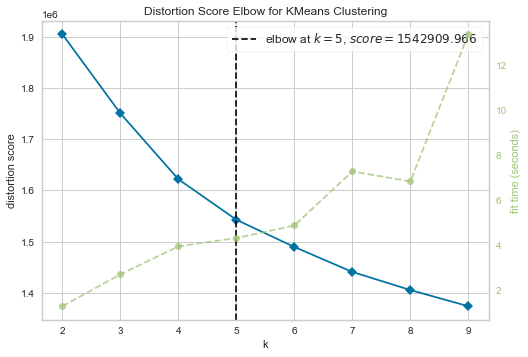

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [115]:
from yellowbrick.cluster import KElbowVisualizer

# Visualizing the elbow choosing the best number of clusters
visualizer=KElbowVisualizer(KMeans(n_clusters = 9), k=(2,10))#, metric='silhouette')
visualizer.fit(airline_test_transf)
visualizer.poof()

In [116]:
kmeans_model = KMeans(n_clusters=5)

# Fitting the model
kmeans_model.fit(X_airline_train)

KMeans(n_clusters=5)

In [117]:
print("Number of clusters defined:", len(set(kmeans_model.labels_)))

Number of clusters defined: 5


In [118]:
airline_train_cluster = transform_dataset(pd.read_csv("Airline_Dataset.csv"),transform=False,scaler=False)

airline_train_cluster["Cluster_KMeans"] = kmeans_model.labels_

airline_train_cluster

,Gender,Loyal,Age,Business Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,Dissatisfied,Cluster_KMeans
id,,,,,,,,,,,,,,,,,,,,,,,,
1,0,0,48,1,Business,821,3,3,3,3,5,3,5,5,3,2,5,4,5,5,2,5.0,1,2
2,1,1,35,1,Business,821,2,2,2,2,3,5,4,5,5,5,5,3,5,5,26,39.0,0,3
3,0,1,41,1,Business,853,4,4,4,4,5,5,5,3,3,3,3,4,3,5,0,0.0,0,1
4,0,1,50,1,Business,1905,2,2,2,2,4,4,5,5,5,5,5,3,5,4,0,0.0,0,3
5,1,1,49,1,Business,3470,3,3,3,3,4,5,4,3,3,4,3,3,3,5,0,1.0,0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129876,0,1,28,0,Eco Plus,447,4,4,4,2,4,4,1,4,5,4,4,4,5,4,2,3.0,1,1
129877,0,1,41,0,Eco Plus,308,3,5,3,4,2,3,2,2,5,5,5,5,4,2,0,0.0,1,4
129878,0,1,42,0,Eco Plus,337,2,5,2,1,3,2,3,3,3,4,5,4,4,3,6,14.0,1,2


In [119]:
airline_train_cluster.groupby("Cluster_KMeans").mean()

,Gender,Loyal,Age,Business Travel,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,Dissatisfied
Cluster_KMeans,,,,,,,,,,,,,,,,,,,,,,
0,0.577814,0.910772,46.594051,0.671463,1202.384445,2.573714,2.952733,2.781270,2.902251,3.207114,3.457516,3.493167,2.495860,2.104944,2.332958,2.215916,2.847950,2.183481,3.146423,15.932275,16.570081,0.758159
1,0.508524,0.871133,41.109267,0.796416,1355.214466,4.171844,4.155182,4.148046,3.944010,3.715273,4.125121,4.031191,4.161834,3.944656,3.867226,4.118340,3.618599,4.137068,3.872490,13.487633,13.651775,0.264127
2,0.488419,0.649706,30.821133,0.469908,660.778885,2.011293,2.832115,1.798769,2.885700,4.020637,2.098446,3.842434,4.073026,3.285771,3.023382,3.734334,3.158275,3.775696,4.025287,12.493512,12.974899,0.860281
3,0.512845,0.952852,45.410880,0.919492,1806.194376,2.120070,1.971124,2.026277,1.901303,3.595658,4.118478,4.220946,4.345794,4.271070,4.157244,4.329450,3.841205,4.335401,3.919660,13.968526,14.046136,0.151754
4,0.453386,0.690663,32.947948,0.571662,895.074815,2.362005,3.044295,2.589278,2.963607,1.623713,2.284254,1.729955,1.793896,3.216688,3.259859,3.676671,3.027439,3.693345,1.601856,17.452914,18.009092,0.846817


<Figure size 1152x1152 with 0 Axes>

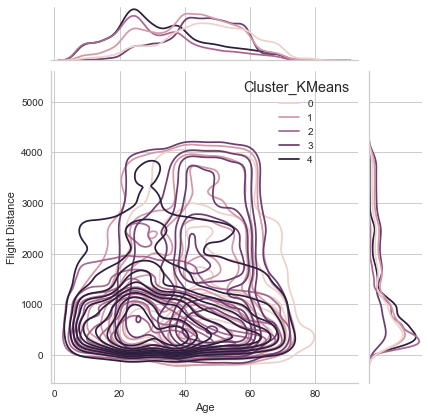

In [120]:
plt.figure(figsize=(16,16))
sns.jointplot(data=airline_train_cluster, x="Age",y="Flight Distance",hue="Cluster_KMeans", kind='kde')

In [121]:
cluster_airline_train = pd.merge(X_airline_train, Y_airline_train, on=Y_airline_train.index)

cluster_airline_train.set_index("key_0",inplace=True)

cluster_airline_train["Cluster_KMeans"] = kmeans_model.labels_

cluster_airline_train

,PC1,PC2,PC3,PC4,PC5,PC6,Dissatisfied,Cluster_KMeans
key_0,,,,,,,,
1,-2.258990,0.843299,0.652687,0.833870,0.559356,-0.151720,1,2
2,-2.322029,1.684497,-1.134380,-0.331769,-0.832280,0.579617,0,3
3,-1.752555,-1.177131,2.139442,-0.117745,0.261873,-0.325312,0,1
4,-2.515200,1.895778,-0.921065,-0.881804,-0.413513,0.226125,0,3
5,-1.103684,-0.107621,1.510059,-1.577904,-0.522460,-0.636595,0,3
...,...,...,...,...,...,...,...,...
129876,-1.271178,-0.718403,-1.477122,0.665610,-0.387420,0.603013,1,1
129877,0.101744,-1.466115,-2.702478,0.194157,1.499392,0.254376,1,4
129878,0.401990,0.729837,-1.280240,0.577884,1.211001,0.376690,1,2


In [122]:
cluster_airline_train.groupby('Cluster_KMeans').mean()

,PC1,PC2,PC3,PC4,PC5,PC6,Dissatisfied
Cluster_KMeans,,,,,,,
0,1.387702,-0.300147,1.743305,-0.553600,0.180733,0.077610,0.758159
1,-1.899654,-1.328959,-0.002011,0.121669,-0.024798,0.007963,0.264127
2,-0.028978,1.169718,0.275714,1.390902,0.118994,-0.147472,0.860281
3,-1.485553,1.552071,-0.449343,-0.907360,-0.123497,0.071131,0.151754
4,2.189627,-0.537258,-1.406962,0.008991,-0.125739,-0.019745,0.846817


<AxesSubplot:xlabel='PC1', ylabel='PC2'>

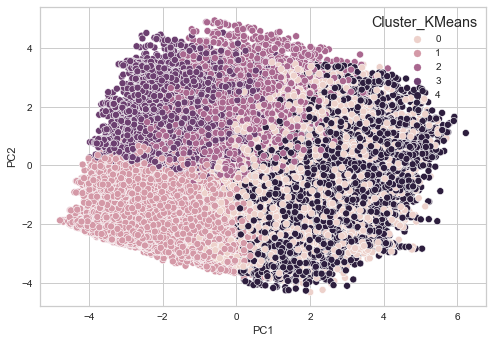

In [123]:
sns.scatterplot(data=cluster_airline_train, x="PC1",y="PC2", hue="Cluster_KMeans")

In [124]:
from sklearn.cluster import DBSCAN

In [125]:
dbscan_model = DBSCAN(eps=1.1)

# Model fitting
dbscan_model.fit(X_airline_train)

# Storing th
e result in a column of our new DataFrame
airline_train_cluster["Cluster_DBSCAN"] = dbscan_model.labels_

In [126]:
print("Number of clusters:", len(set(dbscan_model.labels_)))

Number of clusters: 2


In [127]:
# Looking at the different clusters created:
airline_train_cluster.groupby("Cluster_DBSCAN").mean()

,Gender,Loyal,Age,Business Travel,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,Dissatisfied,Cluster_KMeans
Cluster_DBSCAN,,,,,,,,,,,,,,,,,,,,,,,
-1,0.556872,0.819905,44.322275,0.561611,829.234597,2.106635,2.604265,1.850711,2.741706,2.831754,2.400474,2.805687,2.869668,2.739336,2.625592,2.620853,2.772512,2.703791,2.774882,13.478673,14.267303,0.424171,1.907583
0,0.507222,0.816898,39.412002,0.691004,1191.493426,2.730723,3.059077,2.759829,2.977692,3.205990,3.255411,3.443433,3.359669,3.385121,3.353242,3.635411,3.308007,3.645252,3.287993,14.717739,15.093803,0.565998,1.987224


In [128]:
airline_train_cluster.groupby("Cluster_DBSCAN").count()

,Gender,Loyal,Age,Business Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,Dissatisfied,Cluster_KMeans
Cluster_DBSCAN,,,,,,,,,,,,,,,,,,,,,,,,
-1,422,422,422,422,422,422,422,422,422,422,422,422,422,422,422,422,422,422,422,422,422,419,422,422
0,129458,129458,129458,129458,129458,129458,129458,129458,129458,129458,129458,129458,129458,129458,129458,129458,129458,129458,129458,129458,129458,129068,129458,129458


#### Conclusion: the DBSCAN doesn't perform well in this case, either creating a huge number of clusters or creating not enough clusters. Since this model is too slow to run and it provokes very different results for a slight modification in eps, it is hard to adopt and optimise this model.

In [129]:
lencoders = {}
from sklearn.preprocessing import LabelEncoder
lencoders['Type Of Travel'] = LabelEncoder()
df['Type Of Travel'] = lencoders['Type Of Travel'].fit_transform(df['Type Of Travel'])
lencoders = {}
from sklearn.preprocessing import LabelEncoder
lencoders['Class'] = LabelEncoder()
df['Class'] = lencoders['Class'].fit_transform(df['Class'])

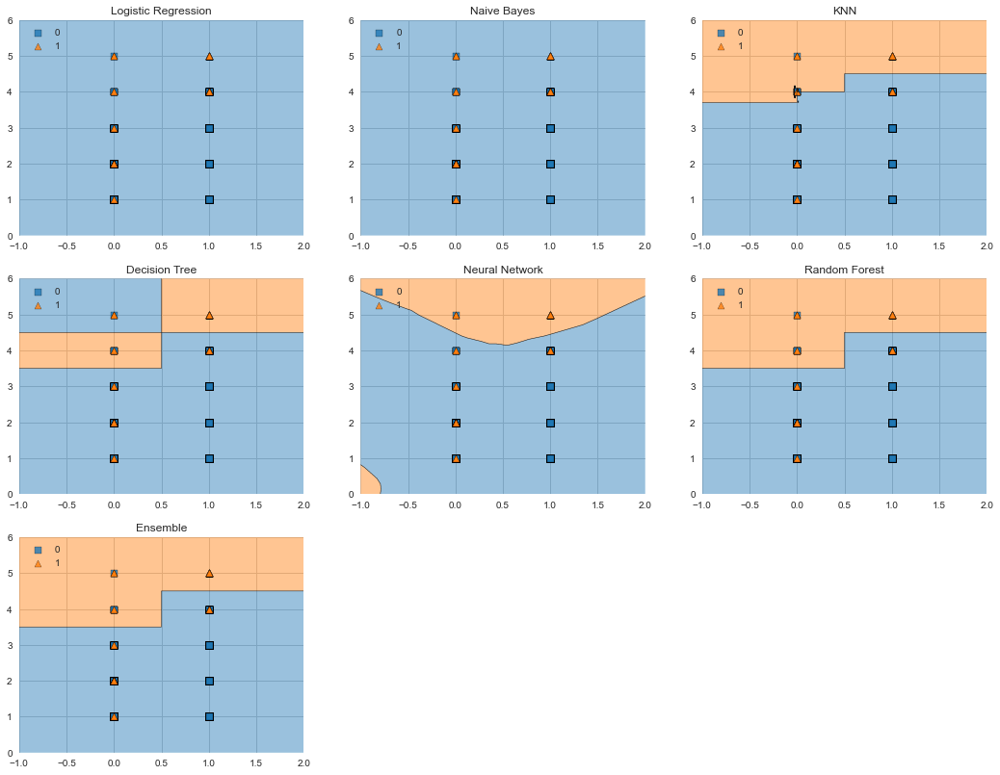

In [130]:
value = 1.70
width = 0.85
from mlxtend.classifier import EnsembleVoteClassifier
import matplotlib.gridspec as gridspec
import itertools
from mlxtend.plotting import plot_decision_regions
import xgboost as xgb
from sklearn.ensemble import AdaBoostClassifier
clf1 = LogisticRegression(random_state=12345)
clf2 = GaussianNB()
clf3 = KNeighborsClassifier()
clf4 = DecisionTreeClassifier(random_state=12345) 
clf5 = MLPClassifier(random_state=12345, verbose = 0)
clf6 = RandomForestClassifier(random_state=12345)
clf7 = xgb.XGBClassifier(random_state=12345)
clf8 = AdaBoostClassifier(random_state=12345)
eclf = EnsembleVoteClassifier(clfs=[clf6, clf7, clf8], weights=[1, 1, 1], voting='soft')


# Considering only the most important features
X_list = df[["Type Of Travel", "Inflight Wifi Service", "Online Boarding", "Class", "Inflight Entertainment"]]
X = np.asarray(X_list, dtype=np.float32)
y_list = df["Satisfaction"]
y = np.asarray(y_list, dtype=np.int32)

# Decision Regions Plotting
gs = gridspec.GridSpec(3,3)
fig = plt.figure(figsize=(18, 14))

labels = ['Logistic Regression',
          'Naive Bayes',
          'KNN',
          'Decision Tree',
          'Neural Network',
          'Random Forest',
          'Ensemble']

for clf, lab, grd in zip([clf1, clf2, clf3, clf4, clf5, clf6, eclf],
                         labels,
                         itertools.product([0, 1, 2],
                         repeat=2)):
    clf.fit(X, y)
    ax = plt.subplot(gs[grd[0], grd[1]])
    fig = plot_decision_regions(X=X, y=y, clf=clf, 
                                filler_feature_values={2: value, 3: value, 4: value}, 
                                filler_feature_ranges={2: width, 3: width, 4: width}, 
                                legend=2)
    plt.title(lab)
    
plt.show()

In [135]:
import plotly.express as px
fig = px.scatter_3d(cluster_airline_train,x='PC1',y='PC2',z='PC3',color='Dissatisfied')
fig.show()